============================================================================
HAND SIGN DATASET - COMPLETE PROCESSING PIPELINE
============================================================================
WORKFLOW:
1. VISUALIZE RAW DATA (BEFORE touching anything!)
2. CLEAN & PROCESS DATA (including blur detection)
3. VISUALIZE CLEANED DATA
4. COMPARE BEFORE vs AFTER
5. ANALYZE LABELS

============================================================================

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image, ImageEnhance
import cv2
from collections import Counter
import warnings
import shutil
from datetime import datetime
import random
warnings.filterwarnings('ignore')

# Set style
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (15, 8)

print("=" * 80)
print("🚀 HAND SIGN DATASET - COMPLETE PROCESSING PIPELINE")
print("=" * 80)

🚀 HAND SIGN DATASET - COMPLETE PROCESSING PIPELINE


In [2]:
# ============================================================================
# SECTION 1: SETUP PATHS
# ============================================================================

# Base directories
BASE_DIR = 'dataset'
TRAIN_DIR = os.path.join(BASE_DIR, 'train')
VALID_DIR = os.path.join(BASE_DIR, 'valid')
TEST_DIR = os.path.join(BASE_DIR, 'test')

# Cleaned data directories
CLEANED_BASE = 'dataset_cleaned'
CLEANED_TRAIN = os.path.join(CLEANED_BASE, 'train')
CLEANED_VALID = os.path.join(CLEANED_BASE, 'valid')
CLEANED_TEST = os.path.join(CLEANED_BASE, 'test')

# Augmented data directories
AUGMENTED_BASE = 'dataset_augmented'
AUGMENTED_TRAIN = os.path.join(AUGMENTED_BASE, 'train')
AUGMENTED_VALID = os.path.join(AUGMENTED_BASE, 'valid')
AUGMENTED_TEST = os.path.join(AUGMENTED_BASE, 'test')

print(f"\n📂 Original Dataset: {BASE_DIR}")
print(f"📂 Cleaned Dataset: {CLEANED_BASE}")
print(f"📂 Augmented Dataset: {AUGMENTED_BASE}")



📂 Original Dataset: dataset
📂 Cleaned Dataset: dataset_cleaned
📂 Augmented Dataset: dataset_augmented


In [3]:
# ============================================================================
# SECTION 2: BLUR DETECTION
# ============================================================================

def detect_blur(image_path, threshold=100):
    """
    Detect if an image is blurry using Laplacian variance
    Lower values = more blurry
    Typical threshold: 100-200
    """
    img = cv2.imread(image_path)
    if img is None:
        return 0, True
    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    laplacian_var = cv2.Laplacian(gray, cv2.CV_64F).var()
    is_blurry = laplacian_var < threshold
    
    return laplacian_var, is_blurry

In [4]:
# ============================================================================
# SECTION 3: DATA LOADING FUNCTIONS
# ============================================================================

def load_images_from_folder(folder_path, check_blur=True, blur_threshold=100):
    """Load all images from a folder with blur detection"""
    images_data = []
    images_dir = os.path.join(folder_path, 'images')
    
    if not os.path.exists(images_dir):
        print(f"⚠️  Warning: {images_dir} not found!")
        return images_data
    
    print(f"   Loading images from {images_dir}...")
    
    for filename in os.listdir(images_dir):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
            img_path = os.path.join(images_dir, filename)
            try:
                img = Image.open(img_path)
                img_array = np.array(img)
                
                # Blur detection
                blur_score = 0
                is_blurry = False
                if check_blur:
                    blur_score, is_blurry = detect_blur(img_path, blur_threshold)
                
                images_data.append({
                    'filename': filename,
                    'path': img_path,
                    'size': img.size,  # (width, height)
                    'mode': img.mode,
                    'format': img.format,
                    'file_size': os.path.getsize(img_path),
                    'shape': img_array.shape,
                    'mean_pixel': np.mean(img_array),
                    'std_pixel': np.std(img_array),
                    'blur_score': blur_score,
                    'is_blurry': is_blurry
                })
            except Exception as e:
                print(f"❌ Error loading {filename}: {e}")
    
    return images_data

def load_labels_from_folder(folder_path):
    """Load all YOLO format labels"""
    labels_data = []
    labels_dir = os.path.join(folder_path, 'labels')
    
    if not os.path.exists(labels_dir):
        print(f"⚠️  Warning: {labels_dir} not found!")
        return labels_data
    
    print(f"   Loading labels from {labels_dir}...")
    
    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            label_path = os.path.join(labels_dir, filename)
            try:
                with open(label_path, 'r') as f:
                    lines = f.readlines()
                    
                for line in lines:
                    parts = line.strip().split()
                    if len(parts) >= 5:
                        class_id = int(parts[0])
                        x_center = float(parts[1])
                        y_center = float(parts[2])
                        width = float(parts[3])
                        height = float(parts[4])
                        
                        labels_data.append({
                            'filename': filename,
                            'class_id': class_id,
                            'x_center': x_center,
                            'y_center': y_center,
                            'width': width,
                            'height': height,
                            'area': width * height
                        })
            except Exception as e:
                print(f"❌ Error loading {filename}: {e}")
    
    return labels_data

def get_dataset_statistics(base_dir, check_blur=True):
    """Get complete statistics for the dataset"""
    stats = {}
    
    for split in ['train', 'valid', 'test']:
        split_dir = os.path.join(base_dir, split)
        print(f"\n📊 Loading {split.upper()} data...")
        
        images_data = load_images_from_folder(split_dir, check_blur=check_blur)
        labels_data = load_labels_from_folder(split_dir)
        
        if images_data:
            df_images = pd.DataFrame(images_data)
            df_labels = pd.DataFrame(labels_data) if labels_data else pd.DataFrame()
            
            stats[split] = {
                'dataframe': df_images,
                'labels_dataframe': df_labels,
                'count': len(df_images),
                'label_count': len(df_labels),
                'total_size_mb': df_images['file_size'].sum() / (1024 * 1024),
                'blurry_count': df_images['is_blurry'].sum() if check_blur else 0
            }
            print(f"   ✅ Loaded {len(df_images)} images and {len(df_labels)} labels")
            if check_blur:
                print(f"   🔍 Detected {stats[split]['blurry_count']} blurry images")
        else:
            stats[split] = {
                'dataframe': pd.DataFrame(),
                'labels_dataframe': pd.DataFrame(),
                'count': 0,
                'label_count': 0,
                'total_size_mb': 0,
                'blurry_count': 0
            }
            print(f"   ⚠️  No images found")
    
    return stats


In [5]:
# ============================================================================
# SECTION 4: AUGMENTATION FUNCTIONS
# ============================================================================

def augment_image(image, label_data=None):
    """
    Apply random augmentation to image (and adjust labels if provided)
    
    Augmentations preserve sign meaning:
    - Small rotations (±10° to ±15°)
    - Scaling / zoom (0.9 – 1.1)
    - Translation (small x/y shifts)
    - Brightness & contrast changes
    - Gaussian noise (very light)
    - Random crop + resize
    """
    img = image.copy()
    width, height = img.size
    
    # Convert to numpy for some operations
    img_array = np.array(img)
    
    # 1. Small rotation (±10° to ±15°)
    if random.random() > 0.5:
        angle = random.uniform(-15, 15)
        img = img.rotate(angle, fillcolor=(0, 0, 0), expand=False)
    
    # 2. Scaling / Zoom (0.9 - 1.1)
    if random.random() > 0.5:
        scale = random.uniform(0.9, 1.1)
        new_width = int(width * scale)
        new_height = int(height * scale)
        img = img.resize((new_width, new_height), Image.LANCZOS)
        
        # Crop or pad to original size
        if scale > 1.0:
            # Crop center
            left = (new_width - width) // 2
            top = (new_height - height) // 2
            img = img.crop((left, top, left + width, top + height))
        else:
            # Pad to original size
            new_img = Image.new('RGB', (width, height), (0, 0, 0))
            paste_x = (width - new_width) // 2
            paste_y = (height - new_height) // 2
            new_img.paste(img, (paste_x, paste_y))
            img = new_img
    
    # 3. Translation (small x/y shifts - up to 10% of image size)
    if random.random() > 0.5:
        tx = random.randint(-int(width * 0.1), int(width * 0.1))
        ty = random.randint(-int(height * 0.1), int(height * 0.1))
        img = img.transform(img.size, Image.AFFINE, (1, 0, tx, 0, 1, ty), fillcolor=(0, 0, 0))
    
    # 4. Brightness adjustment (0.8 - 1.2)
    if random.random() > 0.5:
        enhancer = ImageEnhance.Brightness(img)
        factor = random.uniform(0.8, 1.2)
        img = enhancer.enhance(factor)
    
    # 5. Contrast adjustment (0.8 - 1.2)
    if random.random() > 0.5:
        enhancer = ImageEnhance.Contrast(img)
        factor = random.uniform(0.8, 1.2)
        img = enhancer.enhance(factor)
    
    # 6. Gaussian noise (very light)
    if random.random() > 0.5:
        img_array = np.array(img)
        noise = np.random.normal(0, 5, img_array.shape)  # Very light noise
        img_array = np.clip(img_array + noise, 0, 255).astype(np.uint8)
        img = Image.fromarray(img_array)
    
    # 7. Random crop + resize (90-100% of original)
    if random.random() > 0.5:
        crop_percent = random.uniform(0.9, 1.0)
        new_width = int(width * crop_percent)
        new_height = int(height * crop_percent)
        
        left = random.randint(0, width - new_width)
        top = random.randint(0, height - new_height)
        
        img = img.crop((left, top, left + new_width, top + new_height))
        img = img.resize((width, height), Image.LANCZOS)
    
    return img

def augment_dataset(stats, augmentations_per_image=3, splits_to_augment=['train']):
    """
    Augment the dataset by creating multiple versions of each image
    
    Args:
        stats: Dataset statistics dictionary
        augmentations_per_image: Number of augmented versions to create per image
        splits_to_augment: Which splits to augment (default: only train)
    """
    print(f"\n{'='*80}")
    print(f"🎨 AUGMENTING DATASET")
    print(f"{'='*80}")
    print(f"  Creating {augmentations_per_image} augmented versions per image")
    print(f"  Augmenting: {', '.join(splits_to_augment)}")
    
    augmented_stats = {}
    
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] == 0:
            augmented_stats[split] = stats[split].copy()
            continue
        
        print(f"\n📂 Processing {split.upper()}...")
        
        # Create output directories
        split_dir = os.path.join(AUGMENTED_BASE, split)
        os.makedirs(os.path.join(split_dir, 'images'), exist_ok=True)
        os.makedirs(os.path.join(split_dir, 'labels'), exist_ok=True)
        
        df_images = stats[split]['dataframe']
        df_labels = stats[split]['labels_dataframe']
        
        augmented_image_data = []
        augmented_label_data = []
        
        # First, copy original images
        for idx, row in df_images.iterrows():
            src_img = row['path']
            dst_img = os.path.join(split_dir, 'images', row['filename'])
            shutil.copy2(src_img, dst_img)
            
            # Copy original data
            new_row = row.copy()
            new_row['path'] = dst_img
            augmented_image_data.append(new_row)
            
            # Copy label
            label_name = os.path.splitext(row['filename'])[0] + '.txt'
            src_label_path = os.path.join(os.path.dirname(os.path.dirname(row['path'])), 'labels', label_name)
            if os.path.exists(src_label_path):
                dst_label = os.path.join(split_dir, 'labels', label_name)
                shutil.copy2(src_label_path, dst_label)
                
                # Copy label data
                img_labels = df_labels[df_labels['filename'] == label_name]
                for _, label_row in img_labels.iterrows():
                    augmented_label_data.append(label_row.copy())
        
        # Only augment specified splits
        if split in splits_to_augment:
            print(f"  🎨 Creating {augmentations_per_image} augmentations per image...")
            
            for idx, row in df_images.iterrows():
                img_path = row['path']
                filename = row['filename']
                base_name = os.path.splitext(filename)[0]
                ext = os.path.splitext(filename)[1]
                
                try:
                    # Load original image
                    img = Image.open(img_path)
                    
                    # Get labels for this image
                    label_name = base_name + '.txt'
                    src_label_path = os.path.join(os.path.dirname(os.path.dirname(img_path)), 'labels', label_name)
                    img_labels = df_labels[df_labels['filename'] == label_name] if os.path.exists(src_label_path) else pd.DataFrame()
                    
                    # Create augmented versions
                    for aug_idx in range(augmentations_per_image):
                        # Augment image
                        aug_img = augment_image(img)
                        
                        # Save augmented image
                        aug_filename = f"{base_name}_aug{aug_idx+1}{ext}"
                        aug_path = os.path.join(split_dir, 'images', aug_filename)
                        aug_img.save(aug_path)
                        
                        # Create image data entry
                        aug_row = row.copy()
                        aug_row['filename'] = aug_filename
                        aug_row['path'] = aug_path
                        aug_row['file_size'] = os.path.getsize(aug_path)
                        augmented_image_data.append(aug_row)
                        
                        # Copy and rename label file
                        if len(img_labels) > 0:
                            aug_label_name = f"{base_name}_aug{aug_idx+1}.txt"
                            aug_label_path = os.path.join(split_dir, 'labels', aug_label_name)
                            
                            # Copy label content
                            with open(src_label_path, 'r') as f:
                                label_content = f.read()
                            with open(aug_label_path, 'w') as f:
                                f.write(label_content)
                            
                            # Add label data
                            for _, label_row in img_labels.iterrows():
                                aug_label_row = label_row.copy()
                                aug_label_row['filename'] = aug_label_name
                                augmented_label_data.append(aug_label_row)
                    
                    if (idx + 1) % 50 == 0:
                        print(f"    Processed {idx + 1}/{len(df_images)} images...")
                        
                except Exception as e:
                    print(f"❌ Error augmenting {filename}: {e}")
            
            print(f"  ✅ Original: {len(df_images)} images")
            print(f"  ✅ Total (with augmentations): {len(augmented_image_data)} images")
        else:
            print(f"  ⏭️  Skipping augmentation for {split.upper()}")
        
        # Create new dataframes
        augmented_stats[split] = {
            'dataframe': pd.DataFrame(augmented_image_data),
            'labels_dataframe': pd.DataFrame(augmented_label_data) if augmented_label_data else pd.DataFrame(),
            'count': len(augmented_image_data),
            'label_count': len(augmented_label_data),
            'total_size_mb': sum([r['file_size'] for r in augmented_image_data]) / (1024 * 1024),
            'blurry_count': 0  # Augmented images should not be blurry
        }
    
    return augmented_stats
# ============================================================================
# SECTION 4: AUGMENTATION FUNCTIONS
# ============================================================================

def augment_image(image, label_data=None):
    """
    Apply random augmentation to image (and adjust labels if provided)
    
    Augmentations preserve sign meaning:
    - Small rotations (±10° to ±15°)
    - Scaling / zoom (0.9 – 1.1)
    - Translation (small x/y shifts)
    - Brightness & contrast changes
    - Gaussian noise (very light)
    - Random crop + resize
    """
    img = image.copy()
    width, height = img.size
    
    # Convert to numpy for some operations
    img_array = np.array(img)
    
    # 1. Small rotation (±10° to ±15°)
    if random.random() > 0.5:
        angle = random.uniform(-15, 15)
        img = img.rotate(angle, fillcolor=(0, 0, 0), expand=False)
    
    # 2. Scaling / Zoom (0.9 - 1.1)
    if random.random() > 0.5:
        scale = random.uniform(0.9, 1.1)
        new_width = int(width * scale)
        new_height = int(height * scale)
        img = img.resize((new_width, new_height), Image.LANCZOS)
        
        # Crop or pad to original size
        if scale > 1.0:
            # Crop center
            left = (new_width - width) // 2
            top = (new_height - height) // 2
            img = img.crop((left, top, left + width, top + height))
        else:
            # Pad to original size
            new_img = Image.new('RGB', (width, height), (0, 0, 0))
            paste_x = (width - new_width) // 2
            paste_y = (height - new_height) // 2
            new_img.paste(img, (paste_x, paste_y))
            img = new_img
    
    # 3. Translation (small x/y shifts - up to 10% of image size)
    if random.random() > 0.5:
        tx = random.randint(-int(width * 0.1), int(width * 0.1))
        ty = random.randint(-int(height * 0.1), int(height * 0.1))
        img = img.transform(img.size, Image.AFFINE, (1, 0, tx, 0, 1, ty), fillcolor=(0, 0, 0))
    
    # 4. Brightness adjustment (0.8 - 1.2)
    if random.random() > 0.5:
        enhancer = ImageEnhance.Brightness(img)
        factor = random.uniform(0.8, 1.2)
        img = enhancer.enhance(factor)
    
    # 5. Contrast adjustment (0.8 - 1.2)
    if random.random() > 0.5:
        enhancer = ImageEnhance.Contrast(img)
        factor = random.uniform(0.8, 1.2)
        img = enhancer.enhance(factor)
    
    # 6. Gaussian noise (very light)
    if random.random() > 0.5:
        img_array = np.array(img)
        noise = np.random.normal(0, 5, img_array.shape)  # Very light noise
        img_array = np.clip(img_array + noise, 0, 255).astype(np.uint8)
        img = Image.fromarray(img_array)
    
    # 7. Random crop + resize (90-100% of original)
    if random.random() > 0.5:
        crop_percent = random.uniform(0.9, 1.0)
        new_width = int(width * crop_percent)
        new_height = int(height * crop_percent)
        
        left = random.randint(0, width - new_width)
        top = random.randint(0, height - new_height)
        
        img = img.crop((left, top, left + new_width, top + new_height))
        img = img.resize((width, height), Image.LANCZOS)
    
    return img

def augment_dataset(stats, augmentations_per_image=3, splits_to_augment=['train']):
    """
    Augment the dataset by creating multiple versions of each image
    
    Args:
        stats: Dataset statistics dictionary
        augmentations_per_image: Number of augmented versions to create per image
        splits_to_augment: Which splits to augment (default: only train)
    """
    print(f"\n{'='*80}")
    print(f"🎨 AUGMENTING DATASET")
    print(f"{'='*80}")
    print(f"  Creating {augmentations_per_image} augmented versions per image")
    print(f"  Augmenting: {', '.join(splits_to_augment)}")
    
    augmented_stats = {}
    
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] == 0:
            augmented_stats[split] = stats[split].copy()
            continue
        
        print(f"\n📂 Processing {split.upper()}...")
        
        # Create output directories
        split_dir = os.path.join(AUGMENTED_BASE, split)
        os.makedirs(os.path.join(split_dir, 'images'), exist_ok=True)
        os.makedirs(os.path.join(split_dir, 'labels'), exist_ok=True)
        
        df_images = stats[split]['dataframe']
        df_labels = stats[split]['labels_dataframe']
        
        augmented_image_data = []
        augmented_label_data = []
        
        # First, copy original images
        for idx, row in df_images.iterrows():
            src_img = row['path']
            dst_img = os.path.join(split_dir, 'images', row['filename'])
            shutil.copy2(src_img, dst_img)
            
            # Copy original data
            new_row = row.copy()
            new_row['path'] = dst_img
            augmented_image_data.append(new_row)
            
            # Copy label
            label_name = os.path.splitext(row['filename'])[0] + '.txt'
            src_label_path = os.path.join(os.path.dirname(os.path.dirname(row['path'])), 'labels', label_name)
            if os.path.exists(src_label_path):
                dst_label = os.path.join(split_dir, 'labels', label_name)
                shutil.copy2(src_label_path, dst_label)
                
                # Copy label data
                img_labels = df_labels[df_labels['filename'] == label_name]
                for _, label_row in img_labels.iterrows():
                    augmented_label_data.append(label_row.copy())
        
        # Only augment specified splits
        if split in splits_to_augment:
            print(f"  🎨 Creating {augmentations_per_image} augmentations per image...")
            
            for idx, row in df_images.iterrows():
                img_path = row['path']
                filename = row['filename']
                base_name = os.path.splitext(filename)[0]
                ext = os.path.splitext(filename)[1]
                
                try:
                    # Load original image
                    img = Image.open(img_path)
                    
                    # Get labels for this image
                    label_name = base_name + '.txt'
                    src_label_path = os.path.join(os.path.dirname(os.path.dirname(img_path)), 'labels', label_name)
                    img_labels = df_labels[df_labels['filename'] == label_name] if os.path.exists(src_label_path) else pd.DataFrame()
                    
                    # Create augmented versions
                    for aug_idx in range(augmentations_per_image):
                        # Augment image
                        aug_img = augment_image(img)
                        
                        # Save augmented image
                        aug_filename = f"{base_name}_aug{aug_idx+1}{ext}"
                        aug_path = os.path.join(split_dir, 'images', aug_filename)
                        aug_img.save(aug_path)
                        
                        # Create image data entry
                        aug_row = row.copy()
                        aug_row['filename'] = aug_filename
                        aug_row['path'] = aug_path
                        aug_row['file_size'] = os.path.getsize(aug_path)
                        augmented_image_data.append(aug_row)
                        
                        # Copy and rename label file
                        if len(img_labels) > 0:
                            aug_label_name = f"{base_name}_aug{aug_idx+1}.txt"
                            aug_label_path = os.path.join(split_dir, 'labels', aug_label_name)
                            
                            # Copy label content
                            with open(src_label_path, 'r') as f:
                                label_content = f.read()
                            with open(aug_label_path, 'w') as f:
                                f.write(label_content)
                            
                            # Add label data
                            for _, label_row in img_labels.iterrows():
                                aug_label_row = label_row.copy()
                                aug_label_row['filename'] = aug_label_name
                                augmented_label_data.append(aug_label_row)
                    
                    if (idx + 1) % 50 == 0:
                        print(f"    Processed {idx + 1}/{len(df_images)} images...")
                        
                except Exception as e:
                    print(f"❌ Error augmenting {filename}: {e}")
            
            print(f"  ✅ Original: {len(df_images)} images")
            print(f"  ✅ Total (with augmentations): {len(augmented_image_data)} images")
        else:
            print(f"  ⏭️  Skipping augmentation for {split.upper()}")
        
        # Create new dataframes
        augmented_stats[split] = {
            'dataframe': pd.DataFrame(augmented_image_data),
            'labels_dataframe': pd.DataFrame(augmented_label_data) if augmented_label_data else pd.DataFrame(),
            'count': len(augmented_image_data),
            'label_count': len(augmented_label_data),
            'total_size_mb': sum([r['file_size'] for r in augmented_image_data]) / (1024 * 1024),
            'blurry_count': 0  # Augmented images should not be blurry
        }
    
    return augmented_stats


In [6]:
# ============================================================================
# SECTION 5: VISUALIZATION FUNCTIONS
# ============================================================================

def visualize_raw_dataset(stats, title_prefix="RAW"):
    """Complete visualization of the dataset"""
    
    print(f"\n{'='*80}")
    print(f"📊 {title_prefix} DATASET VISUALIZATION")
    print(f"{'='*80}")
    
    # Combine all data
    all_data = []
    for split, data in stats.items():
        if data['count'] > 0:
            df = data['dataframe'].copy()
            df['split'] = split
            all_data.append(df)
    
    if not all_data:
        print("❌ No data to visualize!")
        return
    
    combined_df = pd.concat(all_data, ignore_index=True)
    
    # ========== FIGURE 1: Dataset Overview ==========
    fig = plt.figure(figsize=(20, 14))
    fig.suptitle(f'{title_prefix} DATASET - COMPLETE OVERVIEW', fontsize=20, fontweight='bold')
    
    # 1. Image count per split
    ax1 = plt.subplot(4, 4, 1)
    split_counts = combined_df['split'].value_counts()
    colors = ['#FF6B6B', '#4ECDC4', '#45B7D1']
    split_counts.plot(kind='bar', color=colors, ax=ax1)
    ax1.set_title('📊 Images per Split', fontsize=12, fontweight='bold')
    ax1.set_xlabel('Split')
    ax1.set_ylabel('Count')
    for i, v in enumerate(split_counts.values):
        ax1.text(i, v + 10, str(v), ha='center', fontweight='bold')
    
    # 2. Total dataset size
    ax2 = plt.subplot(4, 4, 2)
    sizes = [stats[s]['total_size_mb'] for s in ['train', 'valid', 'test'] if stats[s]['count'] > 0]
    labels = [s for s in ['train', 'valid', 'test'] if stats[s]['count'] > 0]
    ax2.pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=90)
    ax2.set_title(f'💾 Total Size: {sum(sizes):.2f} MB', fontsize=12, fontweight='bold')
    
    # 3. Image dimensions distribution
    ax3 = plt.subplot(4, 4, 3)
    widths = [size[0] for size in combined_df['size']]
    heights = [size[1] for size in combined_df['size']]
    ax3.scatter(widths, heights, alpha=0.5, c=combined_df['split'].map({'train': 0, 'valid': 1, 'test': 2}), cmap='viridis')
    ax3.set_title('📏 Image Dimensions', fontsize=12, fontweight='bold')
    ax3.set_xlabel('Width (px)')
    ax3.set_ylabel('Height (px)')
    ax3.grid(True, alpha=0.3)
    
    # 4. File size distribution
    ax4 = plt.subplot(4, 4, 4)
    file_sizes_kb = combined_df['file_size'] / 1024
    ax4.hist(file_sizes_kb, bins=30, color='#95E1D3', edgecolor='black', alpha=0.7)
    ax4.set_title(f'📦 File Size Distribution\nMean: {file_sizes_kb.mean():.1f} KB', fontsize=12, fontweight='bold')
    ax4.set_xlabel('File Size (KB)')
    ax4.set_ylabel('Frequency')
    
    # 5. Blur Score Distribution
    ax5 = plt.subplot(4, 4, 5)
    for split in combined_df['split'].unique():
        split_data = combined_df[combined_df['split'] == split]
        ax5.hist(split_data['blur_score'], bins=20, alpha=0.5, label=split)
    ax5.axvline(x=100, color='red', linestyle='--', label='Blur Threshold')
    ax5.set_title('🔍 Blur Score Distribution', fontsize=12, fontweight='bold')
    ax5.set_xlabel('Blur Score (higher = sharper)')
    ax5.set_ylabel('Frequency')
    ax5.legend()
    
    # 6. Blurry vs Sharp Images
    ax6 = plt.subplot(4, 4, 6)
    blur_counts = combined_df.groupby(['split', 'is_blurry']).size().unstack(fill_value=0)
    blur_counts.plot(kind='bar', stacked=True, ax=ax6, color=['#2ECC71', '#E74C3C'])
    ax6.set_title('🔍 Blurry vs Sharp Images', fontsize=12, fontweight='bold')
    ax6.set_xlabel('Split')
    ax6.set_ylabel('Count')
    ax6.legend(['Sharp', 'Blurry'])
    plt.setp(ax6.xaxis.get_majorticklabels(), rotation=0)
    
    # 7. Image modes
    ax7 = plt.subplot(4, 4, 7)
    mode_counts = combined_df['mode'].value_counts()
    mode_counts.plot(kind='bar', color='#F38181', ax=ax7)
    ax7.set_title('🎨 Image Modes', fontsize=12, fontweight='bold')
    ax7.set_xlabel('Mode')
    ax7.set_ylabel('Count')
    plt.setp(ax7.xaxis.get_majorticklabels(), rotation=0)
    
    # 8. Pixel intensity statistics
    ax8 = plt.subplot(4, 4, 8)
    for split in combined_df['split'].unique():
        split_data = combined_df[combined_df['split'] == split]
        ax8.hist(split_data['mean_pixel'], bins=20, alpha=0.5, label=split)
    ax8.set_title('💡 Mean Pixel Intensity', fontsize=12, fontweight='bold')
    ax8.set_xlabel('Mean Pixel Value')
    ax8.set_ylabel('Frequency')
    ax8.legend()
    
    # 9. Standard deviation
    ax9 = plt.subplot(4, 4, 9)
    combined_df.boxplot(column='std_pixel', by='split', ax=ax9)
    ax9.set_title('📊 Pixel Std Dev by Split', fontsize=12, fontweight='bold')
    ax9.set_xlabel('Split')
    ax9.set_ylabel('Std Dev')
    plt.sca(ax9)
    plt.xticks(rotation=0)
    
    # 10. Image formats
    ax10 = plt.subplot(4, 4, 10)
    format_counts = combined_df['format'].value_counts()
    format_counts.plot(kind='pie', autopct='%1.1f%%', colors=sns.color_palette("pastel"), ax=ax10)
    ax10.set_title('🖼️ Image Formats', fontsize=12, fontweight='bold')
    ax10.set_ylabel('')
    
    # 11. Blur score by split (boxplot)
    ax11 = plt.subplot(4, 4, 11)
    combined_df.boxplot(column='blur_score', by='split', ax=ax11)
    ax11.set_title('🔍 Blur Score by Split', fontsize=12, fontweight='bold')
    ax11.set_xlabel('Split')
    ax11.set_ylabel('Blur Score')
    plt.sca(ax11)
    plt.xticks(rotation=0)
    
    # 12. Aspect ratio distribution
    ax12 = plt.subplot(4, 4, 12)
    aspect_ratios = [size[0] / size[1] for size in combined_df['size']]
    ax12.hist(aspect_ratios, bins=30, color='#A8E6CF', edgecolor='black', alpha=0.7)
    ax12.set_title('📐 Aspect Ratio Distribution', fontsize=12, fontweight='bold')
    ax12.set_xlabel('Aspect Ratio (W/H)')
    ax12.set_ylabel('Frequency')
    
    plt.tight_layout()
    plt.savefig(f'{title_prefix.lower()}_dataset_overview.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # ========== STATISTICS TABLE ==========
    print(f"\n{'='*80}")
    print(f"📈 {title_prefix} DATASET STATISTICS")
    print(f"{'='*80}")
    
    stats_table = []
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] > 0:
            df = stats[split]['dataframe']
            stats_table.append({
                'Split': split.upper(),
                'Images': stats[split]['count'],
                'Labels': stats[split]['label_count'],
                'Blurry': stats[split]['blurry_count'],
                'Total Size (MB)': f"{stats[split]['total_size_mb']:.2f}",
                'Avg Size (KB)': f"{(df['file_size'].mean() / 1024):.2f}",
                'Avg Width': f"{df['size'].apply(lambda x: x[0]).mean():.0f}",
                'Avg Height': f"{df['size'].apply(lambda x: x[1]).mean():.0f}",
                'Avg Blur Score': f"{df['blur_score'].mean():.1f}"
            })
    
    stats_df = pd.DataFrame(stats_table)
    print(stats_df.to_string(index=False))
    
    return combined_df

def visualize_samples_large(stats, title_prefix="RAW", samples_per_split=12):
    """Create large, separate visualizations for sample images from each split"""
    
    print(f"\n{'='*80}")
    print(f"🖼️  CREATING LARGE SAMPLE VISUALIZATIONS")
    print(f"{'='*80}")
    
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] == 0:
            continue
        
        print(f"\n📸 Creating samples for {split.upper()}...")
        
        df = stats[split]['dataframe']
        n_samples = min(samples_per_split, len(df))
        
        # Sample random images
        sample_indices = np.random.choice(len(df), n_samples, replace=False)
        
        # Create figure
        rows = int(np.ceil(np.sqrt(n_samples)))
        cols = int(np.ceil(n_samples / rows))
        
        fig, axes = plt.subplots(rows, cols, figsize=(20, 20))
        fig.suptitle(f'{title_prefix} DATASET - {split.upper()} SAMPLES', 
                     fontsize=24, fontweight='bold', y=0.995)
        
        if rows == 1 and cols == 1:
            axes = [[axes]]
        elif rows == 1 or cols == 1:
            axes = axes.reshape(rows, cols)
        
        for idx, ax in enumerate(axes.flat):
            if idx < n_samples:
                sample_row = df.iloc[sample_indices[idx]]
                img_path = sample_row['path']
                
                try:
                    img = Image.open(img_path)
                    ax.imshow(img)
                    
                    # Add detailed info
                    blur_status = "🔴 BLURRY" if sample_row['is_blurry'] else "🟢 SHARP"
                    info_text = (f"{sample_row['filename']}\n"
                                f"Size: {sample_row['size'][0]}x{sample_row['size'][1]}\n"
                                f"Blur: {sample_row['blur_score']:.1f} {blur_status}\n"
                                f"Mode: {sample_row['mode']}")
                    
                    ax.set_title(info_text, fontsize=10, fontweight='bold')
                    ax.axis('off')
                    
                    # Add colored border based on blur
                    if sample_row['is_blurry']:
                        for spine in ax.spines.values():
                            spine.set_edgecolor('red')
                            spine.set_linewidth(3)
                            spine.set_visible(True)
                except Exception as e:
                    ax.text(0.5, 0.5, f'Error loading\n{sample_row["filename"]}', 
                           ha='center', va='center')
                    ax.axis('off')
            else:
                ax.axis('off')
        
        plt.tight_layout()
        plt.savefig(f'{title_prefix.lower()}_samples_{split}.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        print(f"   ✅ Saved {title_prefix.lower()}_samples_{split}.png")

def visualize_augmentations(original_stats, augmented_stats, samples=5):
    """Visualize original vs augmented images side by side"""
    
    print(f"\n{'='*80}")
    print(f"🎨 VISUALIZING AUGMENTATION EXAMPLES")
    print(f"{'='*80}")
    
    for split in ['train']:  # Usually only train is augmented
        if original_stats[split]['count'] == 0:
            continue
        
        print(f"\n📸 Creating augmentation examples for {split.upper()}...")
        
        orig_df = original_stats[split]['dataframe']
        
        # Sample random images
        n_samples = min(samples, len(orig_df))
        sample_indices = np.random.choice(len(orig_df), n_samples, replace=False)
        
        # Create figure - show original + 3 augmentations per row
        fig, axes = plt.subplots(n_samples, 4, figsize=(20, n_samples * 5))
        fig.suptitle(f'AUGMENTATION EXAMPLES - {split.upper()}\nOriginal | Aug 1 | Aug 2 | Aug 3', 
                     fontsize=20, fontweight='bold', y=0.995)
        
        if n_samples == 1:
            axes = axes.reshape(1, -1)
        
        for row_idx in range(n_samples):
            sample_row = orig_df.iloc[sample_indices[row_idx]]
            base_name = os.path.splitext(sample_row['filename'])[0]
            
            # Show original
            try:
                orig_img = Image.open(sample_row['path'])
                axes[row_idx, 0].imshow(orig_img)
                axes[row_idx, 0].set_title(f'ORIGINAL\n{sample_row["filename"]}', 
                                          fontsize=10, fontweight='bold')
                axes[row_idx, 0].axis('off')
                
                # Add green border to original
                for spine in axes[row_idx, 0].spines.values():
                    spine.set_edgecolor('green')
                    spine.set_linewidth(3)
                    spine.set_visible(True)
            except Exception as e:
                axes[row_idx, 0].text(0.5, 0.5, f'Error\n{str(e)}', ha='center', va='center')
                axes[row_idx, 0].axis('off')
            
            # Show augmented versions
            for aug_idx in range(3):
                aug_filename = f"{base_name}_aug{aug_idx+1}.jpg"
                aug_path = os.path.join(AUGMENTED_BASE, split, 'images', aug_filename)
                
                try:
                    if os.path.exists(aug_path):
                        aug_img = Image.open(aug_path)
                        axes[row_idx, aug_idx + 1].imshow(aug_img)
                        axes[row_idx, aug_idx + 1].set_title(f'AUGMENTED {aug_idx+1}\n{aug_filename}', 
                                                             fontsize=10, fontweight='bold')
                    else:
                        axes[row_idx, aug_idx + 1].text(0.5, 0.5, 'Not found', ha='center', va='center')
                    axes[row_idx, aug_idx + 1].axis('off')
                    
                    # Add blue border to augmented
                    for spine in axes[row_idx, aug_idx + 1].spines.values():
                        spine.set_edgecolor('blue')
                        spine.set_linewidth(3)
                        spine.set_visible(True)
                except Exception as e:
                    axes[row_idx, aug_idx + 1].text(0.5, 0.5, f'Error\n{str(e)}', ha='center', va='center')
                    axes[row_idx, aug_idx + 1].axis('off')
        
        plt.tight_layout()
        plt.savefig(f'augmentation_examples_{split}.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        print(f"   ✅ Saved augmentation_examples_{split}.png")

def visualize_labels(stats, title_prefix="RAW"):
    """Visualize label distributions and statistics"""
    
    print(f"\n{'='*80}")
    print(f"🏷️  {title_prefix} LABEL VISUALIZATION")
    print(f"{'='*80}")
    
    # Combine all labels
    all_labels = []
    for split, data in stats.items():
        if data['label_count'] > 0:
            df = data['labels_dataframe'].copy()
            df['split'] = split
            all_labels.append(df)
    
    if not all_labels:
        print("❌ No labels to visualize!")
        return
    
    combined_labels = pd.concat(all_labels, ignore_index=True)
    
    # ========== LABEL STATISTICS FIGURE ==========
    fig = plt.figure(figsize=(20, 12))
    fig.suptitle(f'{title_prefix} DATASET - LABEL ANALYSIS', fontsize=20, fontweight='bold')
    
    # 1. Class distribution by split
    ax1 = plt.subplot(3, 3, 1)
    class_split = combined_labels.groupby(['split', 'class_id']).size().unstack(fill_value=0)
    class_split.plot(kind='bar', ax=ax1, colormap='Set3')
    ax1.set_title('📊 Class Distribution by Split', fontsize=12, fontweight='bold')
    ax1.set_xlabel('Split')
    ax1.set_ylabel('Count')
    ax1.legend(title='Class ID', bbox_to_anchor=(1.05, 1))
    plt.setp(ax1.xaxis.get_majorticklabels(), rotation=0)
    
    # 2. Overall class distribution
    ax2 = plt.subplot(3, 3, 2)
    class_counts = combined_labels['class_id'].value_counts().sort_index()
    class_counts.plot(kind='bar', ax=ax2, color='#FF6B6B')
    ax2.set_title('📈 Overall Class Distribution', fontsize=12, fontweight='bold')
    ax2.set_xlabel('Class ID')
    ax2.set_ylabel('Count')
    for i, v in enumerate(class_counts.values):
        ax2.text(i, v + 5, str(v), ha='center', fontweight='bold')
    
    # 3. Bounding box area distribution
    ax3 = plt.subplot(3, 3, 3)
    combined_labels['area'].hist(bins=50, ax=ax3, color='#4ECDC4', edgecolor='black')
    ax3.set_title('📦 Bounding Box Area Distribution', fontsize=12, fontweight='bold')
    ax3.set_xlabel('Normalized Area')
    ax3.set_ylabel('Frequency')
    
    # 4. Box width distribution
    ax4 = plt.subplot(3, 3, 4)
    combined_labels['width'].hist(bins=50, ax=ax4, color='#95E1D3', edgecolor='black')
    ax4.set_title('↔️ Box Width Distribution', fontsize=12, fontweight='bold')
    ax4.set_xlabel('Normalized Width')
    ax4.set_ylabel('Frequency')
    
    # 5. Box height distribution
    ax5 = plt.subplot(3, 3, 5)
    combined_labels['height'].hist(bins=50, ax=ax5, color='#FFE66D', edgecolor='black')
    ax5.set_title('↕️ Box Height Distribution', fontsize=12, fontweight='bold')
    ax5.set_xlabel('Normalized Height')
    ax5.set_ylabel('Frequency')
    
    # 6. Box aspect ratio
    ax6 = plt.subplot(3, 3, 6)
    box_aspect = combined_labels['width'] / combined_labels['height']
    box_aspect = box_aspect.replace([np.inf, -np.inf], np.nan).dropna()
    if len(box_aspect) > 0:
        box_aspect.hist(bins=50, ax=ax6, color='#A8E6CF', edgecolor='black')
    ax6.set_title('📐 Box Aspect Ratio', fontsize=12, fontweight='bold')
    ax6.set_xlabel('Width / Height')
    ax6.set_ylabel('Frequency')
    
    # 7. Center X distribution
    ax7 = plt.subplot(3, 3, 7)
    combined_labels['x_center'].hist(bins=50, ax=ax7, color='#FFB6B9', edgecolor='black')
    ax7.set_title('🎯 X Center Distribution', fontsize=12, fontweight='bold')
    ax7.set_xlabel('Normalized X')
    ax7.set_ylabel('Frequency')
    
    # 8. Center Y distribution
    ax8 = plt.subplot(3, 3, 8)
    combined_labels['y_center'].hist(bins=50, ax=ax8, color='#FEC8D8', edgecolor='black')
    ax8.set_title('🎯 Y Center Distribution', fontsize=12, fontweight='bold')
    ax8.set_xlabel('Normalized Y')
    ax8.set_ylabel('Frequency')
    
    # 9. 2D center distribution heatmap
    ax9 = plt.subplot(3, 3, 9)
    h = ax9.hist2d(combined_labels['x_center'], combined_labels['y_center'], 
                   bins=20, cmap='YlOrRd')
    plt.colorbar(h[3], ax=ax9)
    ax9.set_title('🗺️ Bounding Box Center Heatmap', fontsize=12, fontweight='bold')
    ax9.set_xlabel('X Center')
    ax9.set_ylabel('Y Center')
    
    plt.tight_layout()
    plt.savefig(f'{title_prefix.lower()}_label_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # ========== LABEL STATISTICS TABLE ==========
    print(f"\n{'='*80}")
    print(f"📊 {title_prefix} LABEL STATISTICS")
    print(f"{'='*80}")
    
    label_stats = []
    for split in ['train', 'valid', 'test']:
        if stats[split]['label_count'] > 0:
            df = stats[split]['labels_dataframe']
            label_stats.append({
                'Split': split.upper(),
                'Total Labels': len(df),
                'Unique Classes': df['class_id'].nunique(),
                'Avg Boxes/Image': f"{len(df) / stats[split]['count']:.2f}",
                'Avg Box Area': f"{df['area'].mean():.4f}",
                'Avg Width': f"{df['width'].mean():.4f}",
                'Avg Height': f"{df['height'].mean():.4f}"
            })
    
    label_stats_df = pd.DataFrame(label_stats)
    print(label_stats_df.to_string(index=False))
    
    # Class distribution table
    print(f"\n{'='*80}")
    print(f"📊 CLASS DISTRIBUTION")
    print(f"{'='*80}")
    
    class_dist = combined_labels.groupby(['split', 'class_id']).size().unstack(fill_value=0)
    print(class_dist)

In [7]:
# ============================================================================
# SECTION 6: DATA CLEANING FUNCTIONS
# ============================================================================

def clean_dataset(stats, min_size=32, max_size=4096, target_mode='RGB', 
                 blur_threshold=100, remove_blurry=True):
    """Clean the dataset by removing corrupted/invalid/blurry images"""
    
    print(f"\n{'='*80}")
    print("🧹 CLEANING DATASET")
    print(f"{'='*80}")
    print(f"Criteria:")
    print(f"  - Min size: {min_size}x{min_size} pixels")
    print(f"  - Max size: {max_size}x{max_size} pixels")
    print(f"  - Target mode: {target_mode}")
    print(f"  - Remove blurry: {remove_blurry}")
    print(f"  - Blur threshold: {blur_threshold}")
    
    cleaning_report = []
    
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] == 0:
            continue
            
        print(f"\n📂 Processing {split.upper()}...")
        df = stats[split]['dataframe']
        
        # Filter criteria
        valid_size = df['size'].apply(lambda x: min_size <= x[0] <= max_size and min_size <= x[1] <= max_size)
        valid_mode = df['mode'] == target_mode
        valid_blur = ~df['is_blurry'] if remove_blurry else True
        
        # Combine filters
        all_valid = valid_size & valid_mode & valid_blur
        
        # Get invalid images
        invalid_images = df[~all_valid]
        valid_images = df[all_valid]
        
        cleaning_report.append({
            'Split': split.upper(),
            'Original': len(df),
            'Valid': len(valid_images),
            'Removed': len(invalid_images),
            'Removal Rate': f"{(len(invalid_images)/len(df)*100):.1f}%"
        })
        
        print(f"  ✅ Valid: {len(valid_images)}")
        print(f"  ❌ Removed: {len(invalid_images)}")
        
        if len(invalid_images) > 0:
            print(f"  Reasons:")
            print(f"    - Wrong size: {(~valid_size).sum()}")
            print(f"    - Wrong mode: {(~valid_mode).sum()}")
            if remove_blurry:
                print(f"    - Blurry: {df['is_blurry'].sum()}")
        
        # Update stats with cleaned data
        stats[split]['dataframe'] = valid_images.reset_index(drop=True)
        stats[split]['count'] = len(valid_images)
        stats[split]['blurry_count'] = 0  # All blurry removed
    
    print(f"\n{'='*80}")
    print("📊 CLEANING SUMMARY")
    print(f"{'='*80}")
    report_df = pd.DataFrame(cleaning_report)
    print(report_df.to_string(index=False))
    
    return stats

def copy_cleaned_data(stats):
    """Copy cleaned data to new directory"""
    
    print(f"\n{'='*80}")
    print("💾 COPYING CLEANED DATA")
    print(f"{'='*80}")
    
    # Create directories
    for split_dir in [CLEANED_TRAIN, CLEANED_VALID, CLEANED_TEST]:
        os.makedirs(os.path.join(split_dir, 'images'), exist_ok=True)
        os.makedirs(os.path.join(split_dir, 'labels'), exist_ok=True)
    
    for split, output_dir in [('train', CLEANED_TRAIN), ('valid', CLEANED_VALID), ('test', CLEANED_TEST)]:
        if stats[split]['count'] == 0:
            continue
        
        print(f"\n📂 Copying {split.upper()}...")
        df = stats[split]['dataframe']
        
        for idx, row in df.iterrows():
            # Copy image
            src_img = row['path']
            dst_img = os.path.join(output_dir, 'images', row['filename'])
            shutil.copy2(src_img, dst_img)
            
            # Copy label if exists
            label_name = os.path.splitext(row['filename'])[0] + '.txt'
            src_label = os.path.join(BASE_DIR, split, 'labels', label_name)
            if os.path.exists(src_label):
                dst_label = os.path.join(output_dir, 'labels', label_name)
                shutil.copy2(src_label, dst_label)
        
        print(f"  ✅ Copied {len(df)} images and labels")


In [8]:
# ============================================================================
# SECTION 6.5: CLASS BALANCING AND VISUALIZATION BY CLASS
# ============================================================================

def visualize_samples_by_class(stats, title_prefix="RAW", samples_per_class=3):
    """Visualize sample images for ALL classes in ONE image per split"""
    
    print(f"\n{'='*80}")
    print(f"🎨 VISUALIZING SAMPLES BY CLASS (ALL IN ONE)")
    print(f"{'='*80}")
    
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] == 0 or stats[split]['label_count'] == 0:
            continue
        
        df_images = stats[split]['dataframe']
        df_labels = stats[split]['labels_dataframe']
        
        # Get unique classes
        unique_classes = sorted(df_labels['class_id'].unique())
        
        if len(unique_classes) == 0:
            continue
        
        # Calculate grid size
        n_classes = len(unique_classes)
        cols = samples_per_class  # 3 samples per row
        rows = n_classes  # one row per class
        
        # Create figure - ALL classes in ONE image
        fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))
        fig.suptitle(f'{title_prefix} DATASET - {split.upper()} - ALL CLASSES\n{n_classes} classes', 
                     fontsize=24, fontweight='bold', y=0.998)
        
        # Handle single class case
        if n_classes == 1:
            axes = axes.reshape(1, -1)
        
        # Color map for different classes
        colors = plt.cm.rainbow(np.linspace(0, 1, n_classes))
        
        # For each class
        for class_idx, class_id in enumerate(unique_classes):
            # Get all labels for this class
            class_labels = df_labels[df_labels['class_id'] == class_id]
            
            # Get corresponding images
            label_filenames = class_labels['filename'].apply(lambda x: os.path.splitext(x)[0])
            image_basenames = df_images['filename'].apply(lambda x: os.path.splitext(x)[0])
            class_images = df_images[image_basenames.isin(label_filenames)]
            
            if len(class_images) == 0:
                # Fill row with "No data" message
                for col_idx in range(cols):
                    ax = axes[class_idx, col_idx] if n_classes > 1 else axes[col_idx]
                    ax.text(0.5, 0.5, f'No images\nfor Class {class_id}', 
                           ha='center', va='center', fontsize=12)
                    ax.axis('off')
                continue
            
            # Sample images for this class
            n_samples = min(samples_per_class, len(class_images))
            sample_indices = np.random.choice(len(class_images), n_samples, replace=False)
            
            # Get class color
            class_color = (np.array(colors[class_idx][:3]) * 255).astype(int).tolist()
            
            # Draw samples in the row
            for col_idx in range(cols):
                ax = axes[class_idx, col_idx] if n_classes > 1 else axes[col_idx]
                
                if col_idx < n_samples:
                    sample_row = class_images.iloc[sample_indices[col_idx]]
                    img_path = sample_row['path']
                    filename = sample_row['filename']
                    
                    try:
                        # Load image
                        img = cv2.imread(img_path)
                        if img is None:
                            raise Exception("Could not load image")
                        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                        height, width = img.shape[:2]
                        
                        # Get labels for this image and class
                        label_filename = os.path.splitext(filename)[0] + '.txt'
                        img_labels = class_labels[class_labels['filename'] == label_filename]
                        
                        # Draw bounding boxes
                        for _, label in img_labels.iterrows():
                            x_center = label['x_center'] * width
                            y_center = label['y_center'] * height
                            box_width = label['width'] * width
                            box_height = label['height'] * height
                            
                            x1 = int(x_center - box_width / 2)
                            y1 = int(y_center - box_height / 2)
                            x2 = int(x_center + box_width / 2)
                            y2 = int(y_center + box_height / 2)
                            
                            cv2.rectangle(img, (x1, y1), (x2, y2), class_color, 4)
                            
                            # Add class ID label
                            label_text = f"Class {class_id}"
                            cv2.putText(img, label_text, (x1, y1-10), 
                                       cv2.FONT_HERSHEY_SIMPLEX, 1.0, class_color, 3)
                        
                        ax.imshow(img)
                        
                        # Title with class info and blur status
                        blur_status = "🔴 BLURRY" if sample_row['is_blurry'] else "🟢 SHARP"
                        title_text = f"CLASS {class_id}\n{blur_status}"
                        if col_idx == 0:  # Add class count on first image
                            title_text += f"\n({len(class_images)} total)"
                        
                        ax.set_title(title_text, fontsize=11, fontweight='bold')
                        ax.axis('off')
                        
                        # Add colored border for the class
                        for spine in ax.spines.values():
                            spine.set_edgecolor(np.array(class_color) / 255.0)
                            spine.set_linewidth(4)
                            spine.set_visible(True)
                        
                    except Exception as e:
                        ax.text(0.5, 0.5, f'Error\n{str(e)}', ha='center', va='center')
                        ax.axis('off')
                else:
                    # Empty cell if not enough samples
                    ax.axis('off')
        
        plt.tight_layout()
        filename = f'{title_prefix.lower()}_all_classes_{split}.png'
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()
        
        print(f"✅ Saved: {filename} ({n_classes} classes)")

def balance_dataset(stats, method='undersample', target_samples=None):
    """Balance the dataset by class"""
    
    print(f"\n{'='*80}")
    print(f"⚖️  BALANCING DATASET - Method: {method.upper()}")
    print(f"{'='*80}")
    
    balanced_stats = {}
    
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] == 0 or stats[split]['label_count'] == 0:
            balanced_stats[split] = stats[split].copy()
            continue
        
        print(f"\n📊 Balancing {split.upper()}...")
        
        df_images = stats[split]['dataframe'].copy()
        df_labels = stats[split]['labels_dataframe'].copy()
        
        # Get class distribution
        class_counts = df_labels.groupby('class_id')['filename'].nunique()
        print(f"   Original class distribution:")
        for class_id, count in class_counts.items():
            print(f"      Class {class_id}: {count} images")
        
        if method == 'undersample':
            # Undersample to the minimum class count
            min_count = class_counts.min() if target_samples is None else target_samples
            print(f"\n   Target samples per class: {min_count}")
            
            balanced_image_files = []
            
            for class_id in class_counts.index:
                # Get all label files for this class
                class_label_files = df_labels[df_labels['class_id'] == class_id]['filename'].unique()
                
                # Convert to image filenames
                image_files = [os.path.splitext(f)[0] for f in class_label_files]
                
                # Sample
                if len(image_files) > min_count:
                    sampled_files = np.random.choice(image_files, min_count, replace=False)
                else:
                    sampled_files = image_files
                
                balanced_image_files.extend(sampled_files)
            
            # Filter dataframes
            image_basenames = df_images['filename'].apply(lambda x: os.path.splitext(x)[0])
            balanced_df_images = df_images[image_basenames.isin(balanced_image_files)].reset_index(drop=True)
            
            label_basenames = df_labels['filename'].apply(lambda x: os.path.splitext(x)[0])
            balanced_df_labels = df_labels[label_basenames.isin(balanced_image_files)].reset_index(drop=True)
            
        elif method == 'oversample':
            # Oversample to the maximum class count
            max_count = class_counts.max() if target_samples is None else target_samples
            print(f"\n   Target samples per class: {max_count}")
            
            balanced_image_rows = []
            balanced_label_rows = []
            
            for class_id in class_counts.index:
                # Get all label files for this class
                class_label_files = df_labels[df_labels['class_id'] == class_id]['filename'].unique()
                
                # Convert to image filenames
                image_files = [os.path.splitext(f)[0] for f in class_label_files]
                
                # Get corresponding image rows
                image_basenames = df_images['filename'].apply(lambda x: os.path.splitext(x)[0])
                class_image_rows = df_images[image_basenames.isin(image_files)]
                
                # Oversample
                if len(image_files) < max_count:
                    # Sample with replacement
                    sample_indices = np.random.choice(len(class_image_rows), max_count, replace=True)
                    sampled_rows = class_image_rows.iloc[sample_indices]
                else:
                    sampled_rows = class_image_rows
                
                balanced_image_rows.append(sampled_rows)
                
                # Also get corresponding labels
                label_basenames = df_labels['filename'].apply(lambda x: os.path.splitext(x)[0])
                class_label_rows = df_labels[label_basenames.isin(image_files)]
                
                # Duplicate labels proportionally
                sampled_basenames = sampled_rows['filename'].apply(lambda x: os.path.splitext(x)[0])
                for basename in sampled_basenames:
                    label_filename = basename + '.txt'
                    matching_labels = class_label_rows[class_label_rows['filename'] == label_filename]
                    balanced_label_rows.append(matching_labels)
            
            balanced_df_images = pd.concat(balanced_image_rows, ignore_index=True)
            balanced_df_labels = pd.concat(balanced_label_rows, ignore_index=True)
        
        # Update stats
        new_class_counts = balanced_df_labels.groupby('class_id')['filename'].nunique()
        print(f"\n   Balanced class distribution:")
        for class_id, count in new_class_counts.items():
            print(f"      Class {class_id}: {count} images")
        
        balanced_stats[split] = {
            'dataframe': balanced_df_images,
            'labels_dataframe': balanced_df_labels,
            'count': len(balanced_df_images),
            'label_count': len(balanced_df_labels),
            'total_size_mb': balanced_df_images['file_size'].sum() / (1024 * 1024),
            'blurry_count': balanced_df_images['is_blurry'].sum()
        }
    
    
    return balanced_stats
    
    """Visualize images with their bounding boxes"""
    
    print(f"\n{'='*80}")
    print(f"🎯 VISUALIZING LABELS ON IMAGES")
    print(f"{'='*80}")
    
    for split in ['train', 'valid', 'test']:
        if stats[split]['count'] == 0 or stats[split]['label_count'] == 0:
            continue
        
        print(f"\n📸 Creating labeled samples for {split.upper()}...")
        
        df_images = stats[split]['dataframe']
        df_labels = stats[split]['labels_dataframe']
        
        n_samples = min(samples_per_split, len(df_images))
        sample_indices = np.random.choice(len(df_images), n_samples, replace=False)
        
        rows = int(np.ceil(np.sqrt(n_samples)))
        cols = int(np.ceil(n_samples / rows))
        
        fig, axes = plt.subplots(rows, cols, figsize=(20, 20))
        fig.suptitle(f'{title_prefix} DATASET - {split.upper()} WITH LABELS', 
                     fontsize=24, fontweight='bold', y=0.995)
        
        if rows == 1 and cols == 1:
            axes = [[axes]]
        elif rows == 1 or cols == 1:
            axes = axes.reshape(rows, cols)
        
        # Color map for different classes
        colors = plt.cm.rainbow(np.linspace(0, 1, df_labels['class_id'].nunique() + 1))
        
        for idx, ax in enumerate(axes.flat):
            if idx < n_samples:
                sample_row = df_images.iloc[sample_indices[idx]]
                img_path = sample_row['path']
                filename = sample_row['filename']
                
                try:
                    # Load image
                    img = cv2.imread(img_path)
                    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    height, width = img.shape[:2]
                    
                    # Get labels for this image
                    label_filename = os.path.splitext(filename)[0] + '.txt'
                    img_labels = df_labels[df_labels['filename'] == label_filename]
                    
                    # Draw bounding boxes
                    for _, label in img_labels.iterrows():
                        class_id = int(label['class_id'])
                        x_center = label['x_center'] * width
                        y_center = label['y_center'] * height
                        box_width = label['width'] * width
                        box_height = label['height'] * height
                        
                        x1 = int(x_center - box_width / 2)
                        y1 = int(y_center - box_height / 2)
                        x2 = int(x_center + box_width / 2)
                        y2 = int(y_center + box_height / 2)
                        
                        color = (np.array(colors[class_id][:3]) * 255).astype(int).tolist()
                        cv2.rectangle(img, (x1, y1), (x2, y2), color, 3)
                        
                        label_text = f"Class {class_id}"
                        cv2.putText(img, label_text, (x1, y1-10), 
                                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)
                    
                    ax.imshow(img)
                    ax.set_title(f"{filename}\n{len(img_labels)} boxes", 
                                fontsize=10, fontweight='bold')
                    ax.axis('off')
                    
                except Exception as e:
                    ax.text(0.5, 0.5, f'Error\n{filename}', 
                           ha='center', va='center')
                    ax.axis('off')
            else:
                ax.axis('off')
        
        plt.tight_layout()
        plt.savefig(f'{title_prefix.lower()}_labeled_samples_{split}.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        print(f"   ✅ Saved {title_prefix.lower()}_labeled_samples_{split}.png")


In [9]:
# ============================================================================
# SECTION 7: COMPARISON VISUALIZATION
# ============================================================================

def compare_before_after(raw_stats, cleaned_stats, augmented_stats=None):
    """Compare raw vs cleaned vs augmented datasets"""
    
    print(f"\n{'='*80}")
    print("🔍 BEFORE vs AFTER COMPARISON")
    print(f"{'='*80}")
    
    n_rows = 3 if augmented_stats else 2
    fig, axes = plt.subplots(n_rows, 3, figsize=(20, n_rows * 6))
    title = 'BEFORE vs AFTER CLEANING'
    if augmented_stats:
        title += ' vs AUGMENTED'
    fig.suptitle(title + ' - COMPARISON', fontsize=22, fontweight='bold')
    
    splits = ['train', 'valid', 'test']
    
    for idx, split in enumerate(splits):
        # Before
        ax_before = axes[0, idx]
        if raw_stats[split]['count'] > 0:
            df = raw_stats[split]['dataframe']
            widths = [s[0] for s in df['size']]
            heights = [s[1] for s in df['size']]
            blur = df['blur_score']
            scatter = ax_before.scatter(widths, heights, alpha=0.6, c=blur, 
                                       cmap='RdYlGn', s=50, vmin=0, vmax=200)
            plt.colorbar(scatter, ax=ax_before, label='Blur Score')
            ax_before.set_title(f'RAW - {split.upper()}\n{raw_stats[split]["count"]} images | {raw_stats[split]["blurry_count"]} blurry', 
                              fontsize=12, fontweight='bold')
        else:
            ax_before.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=16)
            ax_before.set_title(f'RAW - {split.upper()}', fontsize=12, fontweight='bold')
        ax_before.set_xlabel('Width (px)')
        ax_before.set_ylabel('Height (px)')
        ax_before.grid(True, alpha=0.3)
        
        # After cleaning
        ax_after = axes[1, idx]
        if cleaned_stats[split]['count'] > 0:
            df = cleaned_stats[split]['dataframe']
            widths = [s[0] for s in df['size']]
            heights = [s[1] for s in df['size']]
            blur = df['blur_score']
            scatter = ax_after.scatter(widths, heights, alpha=0.6, c=blur, 
                                      cmap='RdYlGn', s=50, vmin=0, vmax=200)
            plt.colorbar(scatter, ax=ax_after, label='Blur Score')
            ax_after.set_title(f'CLEANED - {split.upper()}\n{cleaned_stats[split]["count"]} images | {cleaned_stats[split]["blurry_count"]} blurry', 
                             fontsize=12, fontweight='bold')
        else:
            ax_after.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=16)
            ax_after.set_title(f'CLEANED - {split.upper()}', fontsize=12, fontweight='bold')
        ax_after.set_xlabel('Width (px)')
        ax_after.set_ylabel('Height (px)')
        ax_after.grid(True, alpha=0.3)
        
        # After augmentation
        if augmented_stats:
            ax_aug = axes[2, idx]
            if augmented_stats[split]['count'] > 0:
                df = augmented_stats[split]['dataframe']
                widths = [s[0] for s in df['size']]
                heights = [s[1] for s in df['size']]
                blur = df['blur_score']
                scatter = ax_aug.scatter(widths, heights, alpha=0.6, c=blur, 
                                        cmap='RdYlGn', s=50, vmin=0, vmax=200)
                plt.colorbar(scatter, ax=ax_aug, label='Blur Score')
                ax_aug.set_title(f'AUGMENTED - {split.upper()}\n{augmented_stats[split]["count"]} images', 
                               fontsize=12, fontweight='bold')
            else:
                ax_aug.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=16)
                ax_aug.set_title(f'AUGMENTED - {split.upper()}', fontsize=12, fontweight='bold')
            ax_aug.set_xlabel('Width (px)')
            ax_aug.set_ylabel('Height (px)')
            ax_aug.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig('before_after_augmented_comparison.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Statistics comparison table
    comparison = []
    for split in splits:
        row_data = {
            'Split': split.upper(),
            'Raw': raw_stats[split]['count'],
            'Blurry Raw': raw_stats[split]['blurry_count'],
            'Cleaned': cleaned_stats[split]['count'],
            'Blurry Cleaned': cleaned_stats[split]['blurry_count'],
            'Removed': raw_stats[split]['count'] - cleaned_stats[split]['count'],
            'Kept %': f"{(cleaned_stats[split]['count']/raw_stats[split]['count']*100) if raw_stats[split]['count'] > 0 else 0:.1f}%"
        }
        
        if augmented_stats:
            row_data['Augmented'] = augmented_stats[split]['count']
            row_data['Aug Increase'] = f"+{augmented_stats[split]['count'] - cleaned_stats[split]['count']}"
        
        comparison.append(row_data)
    
    comp_df = pd.DataFrame(comparison)
    print("\n" + comp_df.to_string(index=False))


STEP 1: LOADING RAW DATA (NO MODIFICATIONS!)

📊 Loading TRAIN data...
   Loading images from dataset\train\images...
   Loading labels from dataset\train\labels...
   ✅ Loaded 4651 images and 4656 labels
   🔍 Detected 438 blurry images

📊 Loading VALID data...
   Loading images from dataset\valid\images...
   Loading labels from dataset\valid\labels...
   ✅ Loaded 891 images and 870 labels
   🔍 Detected 90 blurry images

📊 Loading TEST data...
   Loading images from dataset\test\images...
   Loading labels from dataset\test\labels...
   ✅ Loaded 290 images and 291 labels
   🔍 Detected 20 blurry images

STEP 2: VISUALIZING RAW DATA

📊 RAW DATASET VISUALIZATION


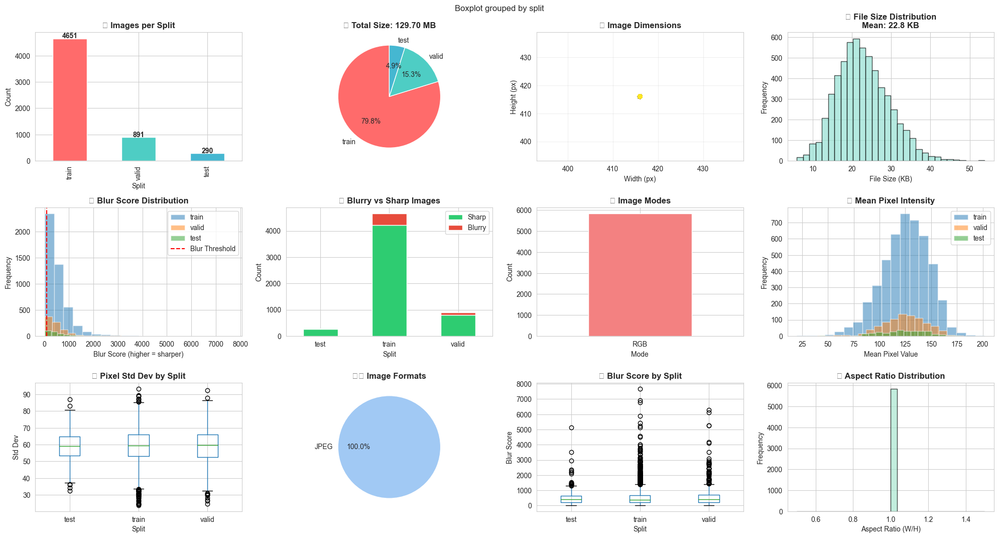


📈 RAW DATASET STATISTICS
Split  Images  Labels  Blurry Total Size (MB) Avg Size (KB) Avg Width Avg Height Avg Blur Score
TRAIN    4651    4656     438          103.45         22.78       416        416          532.6
VALID     891     870      90           19.88         22.85       416        416          569.3
 TEST     290     291      20            6.37         22.50       416        416          531.9

🖼️  CREATING LARGE SAMPLE VISUALIZATIONS

📸 Creating samples for TRAIN...


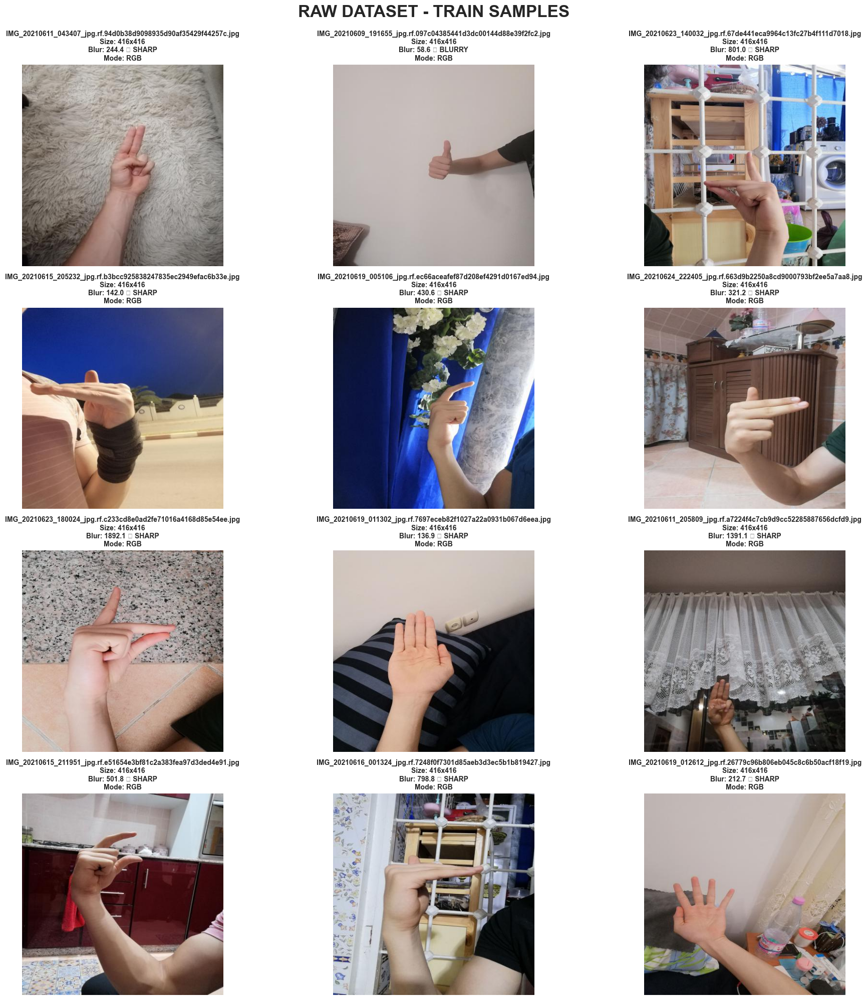

   ✅ Saved raw_samples_train.png

📸 Creating samples for VALID...


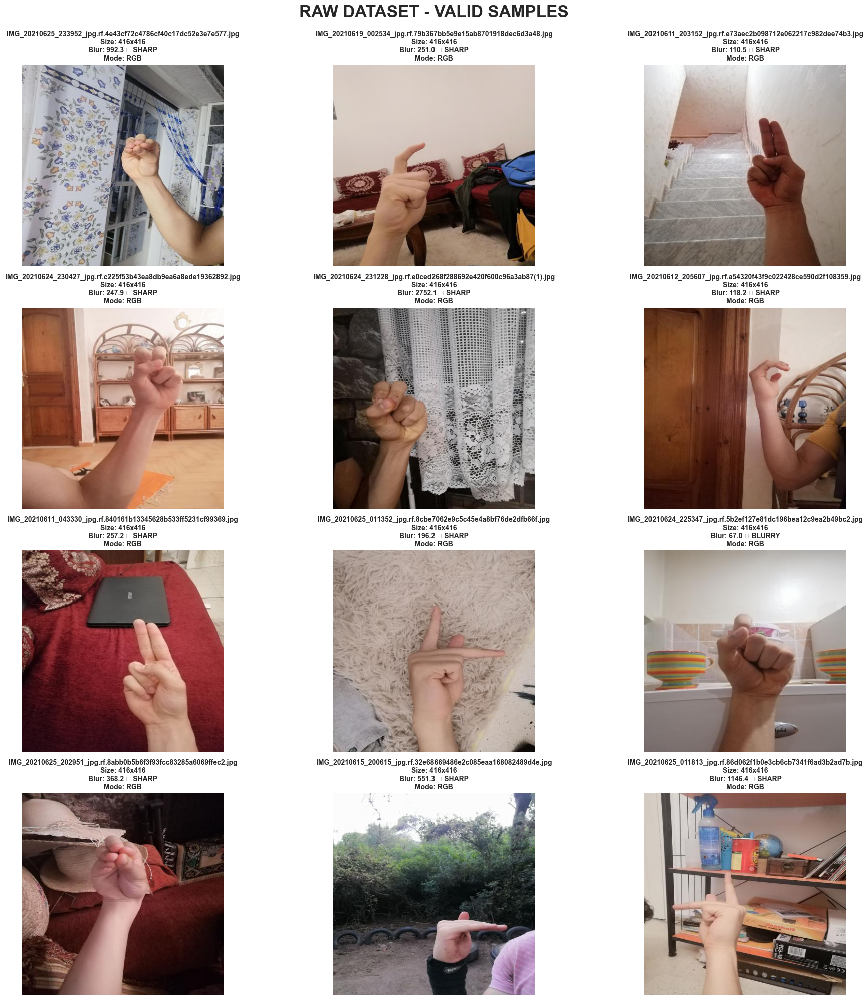

   ✅ Saved raw_samples_valid.png

📸 Creating samples for TEST...


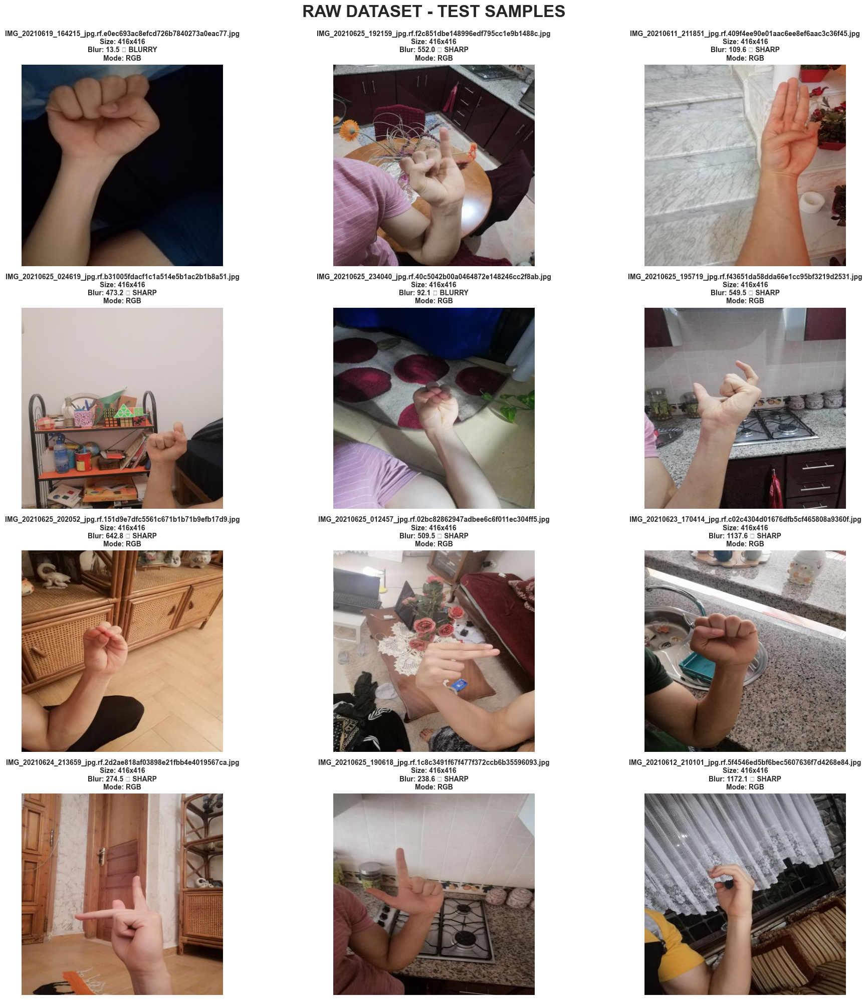

   ✅ Saved raw_samples_test.png

🏷️  RAW LABEL VISUALIZATION


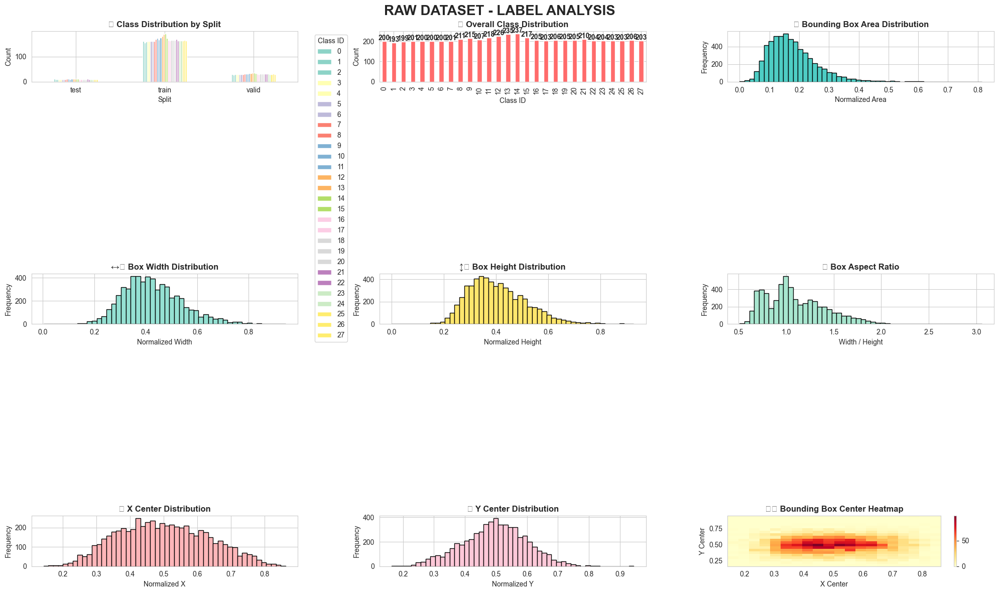


📊 RAW LABEL STATISTICS
Split  Total Labels  Unique Classes Avg Boxes/Image Avg Box Area Avg Width Avg Height
TRAIN          4656              28            1.00       0.1788    0.4273     0.4055
VALID           870              28            0.98       0.1760    0.4240     0.4040
 TEST           291              28            1.00       0.1817    0.4308     0.4055

📊 CLASS DISTRIBUTION
class_id   0    1    2    3    4    5    6    7    8    9   ...   18   19  \
split                                                       ...             
test       11   10   10   10   10   10   10   10   11   11  ...   10   10   
train     160  155  159  161  160  160  160  161  168  172  ...  165  164   
valid      29   28   30   30   30   30   30   30   32   32  ...   31   31   

class_id   20   21   22   23   24   25   26   27  
split                                             
test       10   11   10   10   10   10   10   10  
train     164  168  163  163  163  163  165  163  
valid      31   31  

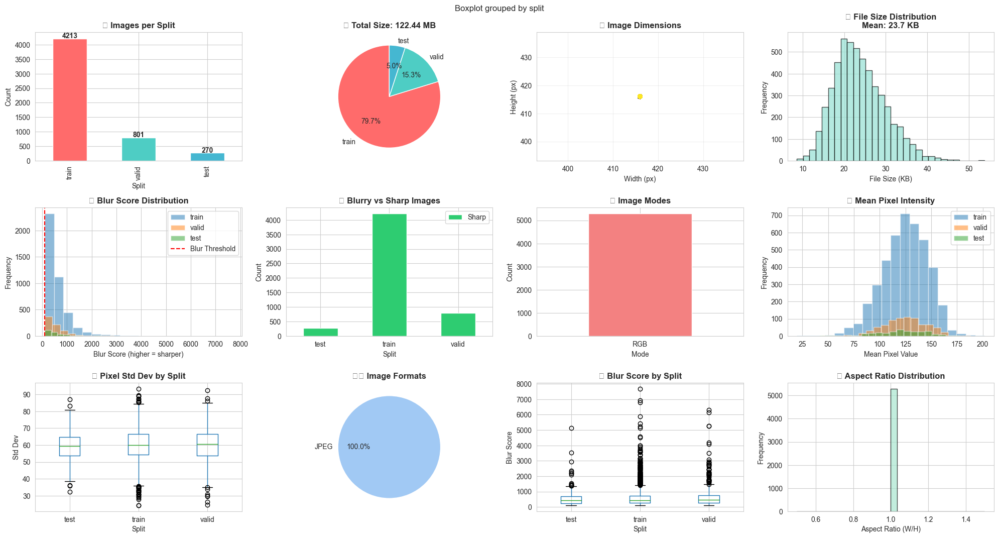


📈 CLEANED DATASET STATISTICS
Split  Images  Labels  Blurry Total Size (MB) Avg Size (KB) Avg Width Avg Height Avg Blur Score
TRAIN    4213    4218       0           97.63         23.73       416        416          581.6
VALID     801     780       0           18.68         23.88       416        416          626.3
 TEST     270     271       0            6.13         23.23       416        416          566.7

🖼️  CREATING LARGE SAMPLE VISUALIZATIONS

📸 Creating samples for TRAIN...


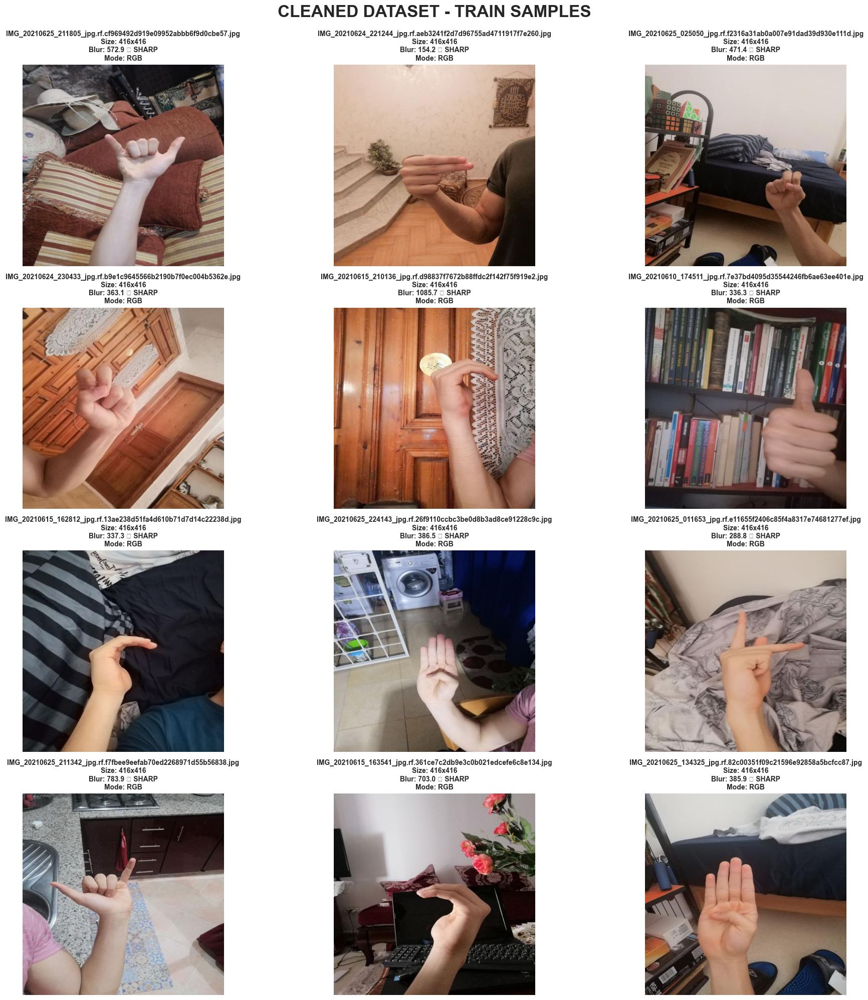

   ✅ Saved cleaned_samples_train.png

📸 Creating samples for VALID...


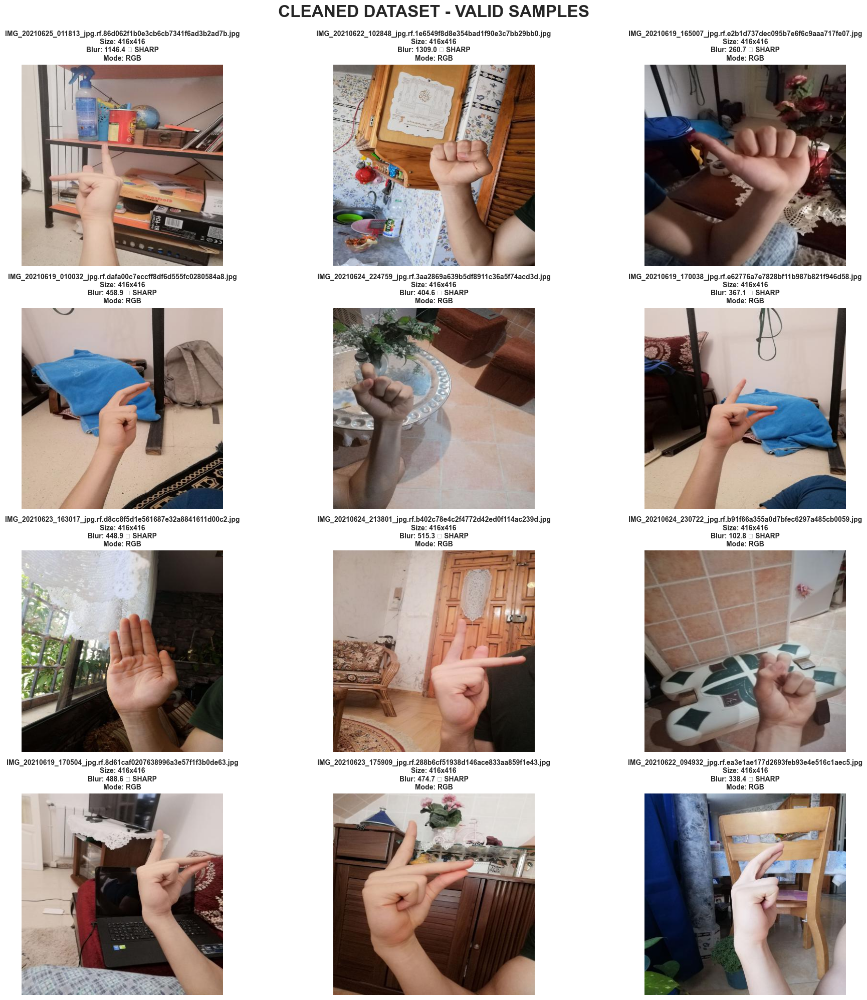

   ✅ Saved cleaned_samples_valid.png

📸 Creating samples for TEST...


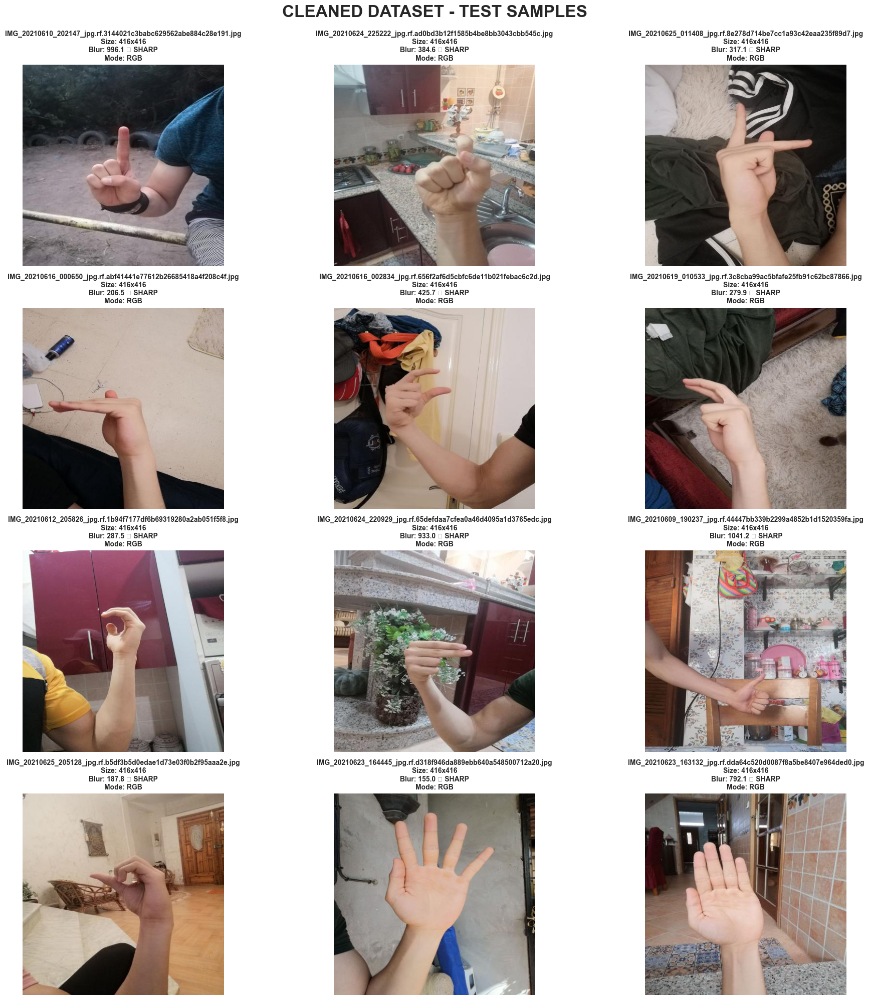

   ✅ Saved cleaned_samples_test.png

🏷️  CLEANED LABEL VISUALIZATION


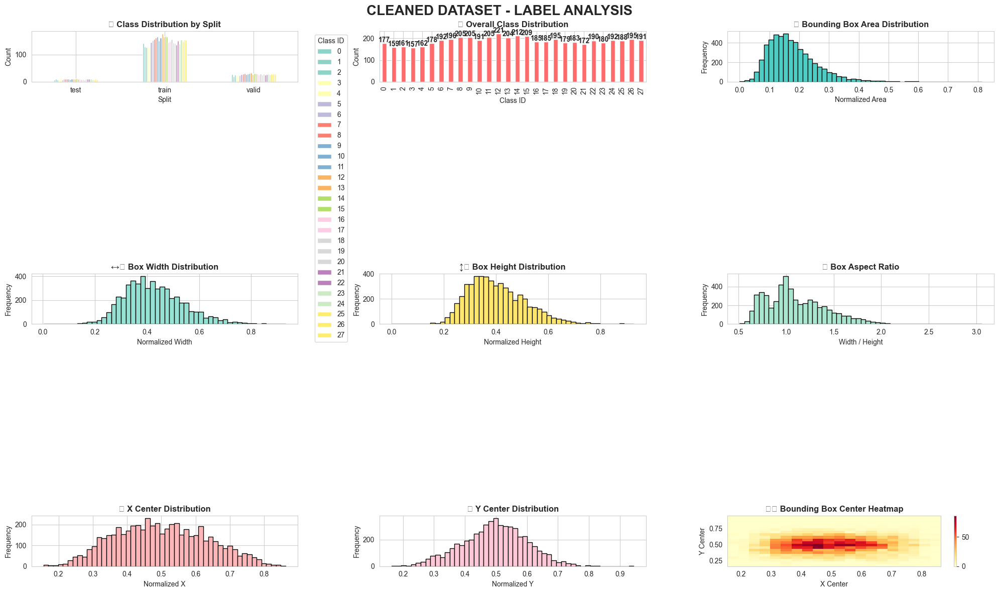


📊 CLEANED LABEL STATISTICS
Split  Total Labels  Unique Classes Avg Boxes/Image Avg Box Area Avg Width Avg Height
TRAIN          4218              28            1.00       0.1777    0.4271     0.4032
VALID           780              28            0.97       0.1737    0.4221     0.4006
 TEST           271              28            1.00       0.1822    0.4318     0.4055

📊 CLASS DISTRIBUTION
class_id   0    1    2    3    4    5    6    7    8    9   ...   18   19  \
split                                                       ...             
test        8   10    8    8   10    8   10   10   11   11  ...    9    8   
train     142  129  128  128  130  146  154  157  162  166  ...  157  145   
valid      27   20   25   21   22   24   28   29   32   28  ...   29   26   

class_id   20   21   22   23   24   25   26   27  
split                                             
test       10   10   10   10    9    9   10    9  
train     143  136  152  141  156  150  155  153  
valid      30   

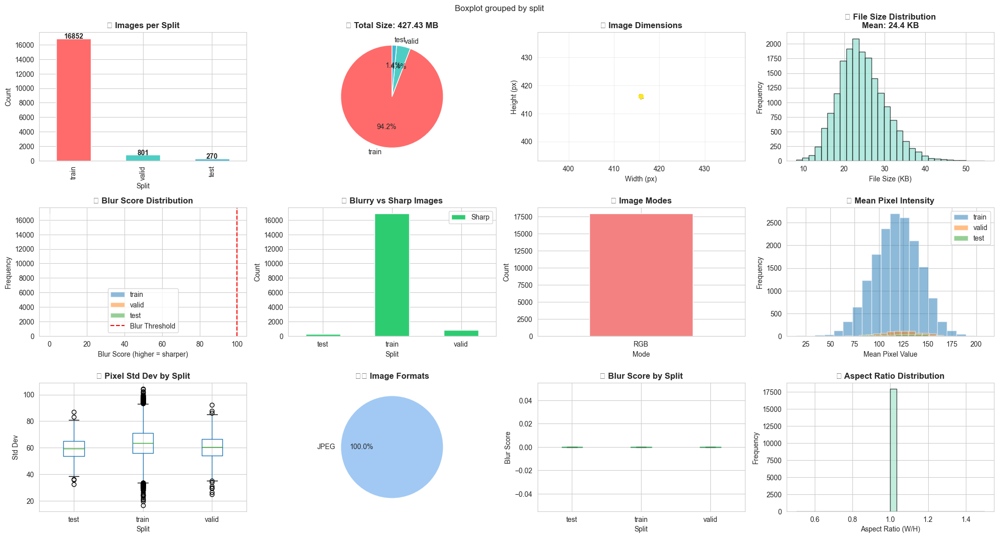


📈 AUGMENTED DATASET STATISTICS
Split  Images  Labels  Blurry Total Size (MB) Avg Size (KB) Avg Width Avg Height Avg Blur Score
TRAIN   16852   16872       0          402.63         24.47       416        416            0.0
VALID     801     780       0           18.68         23.88       416        416            0.0
 TEST     270     271       0            6.13         23.23       416        416            0.0

🖼️  CREATING LARGE SAMPLE VISUALIZATIONS

📸 Creating samples for TRAIN...


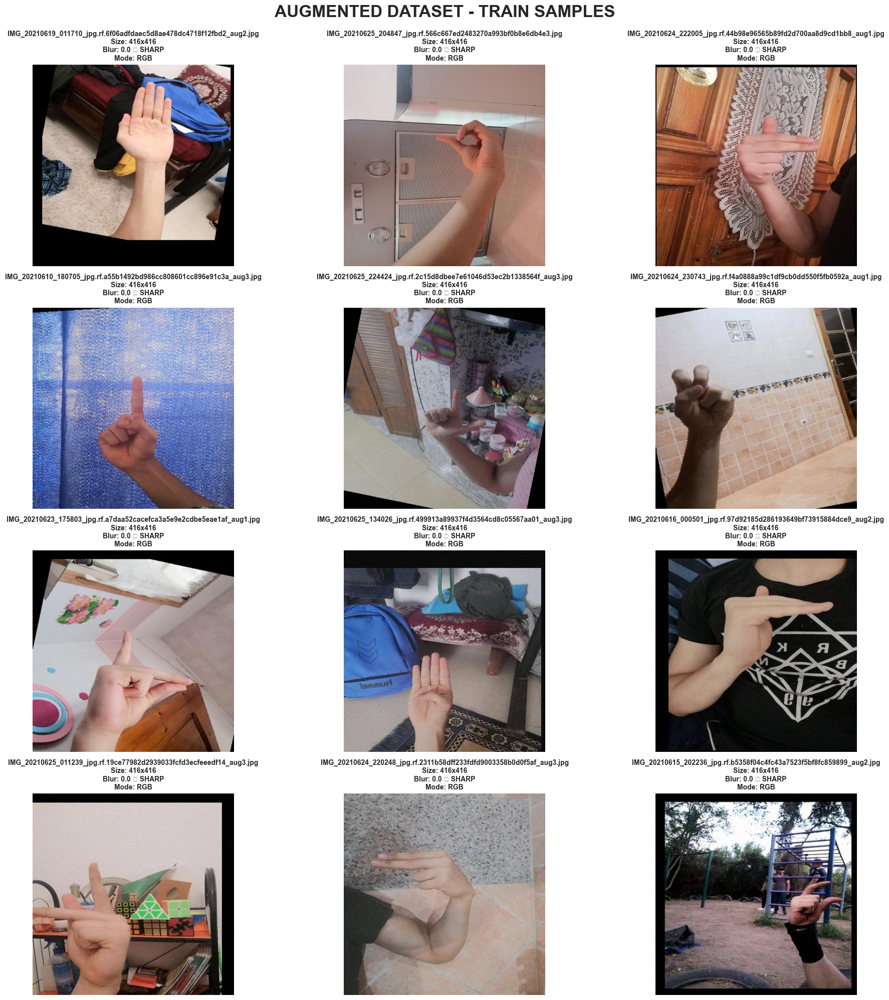

   ✅ Saved augmented_samples_train.png

📸 Creating samples for VALID...


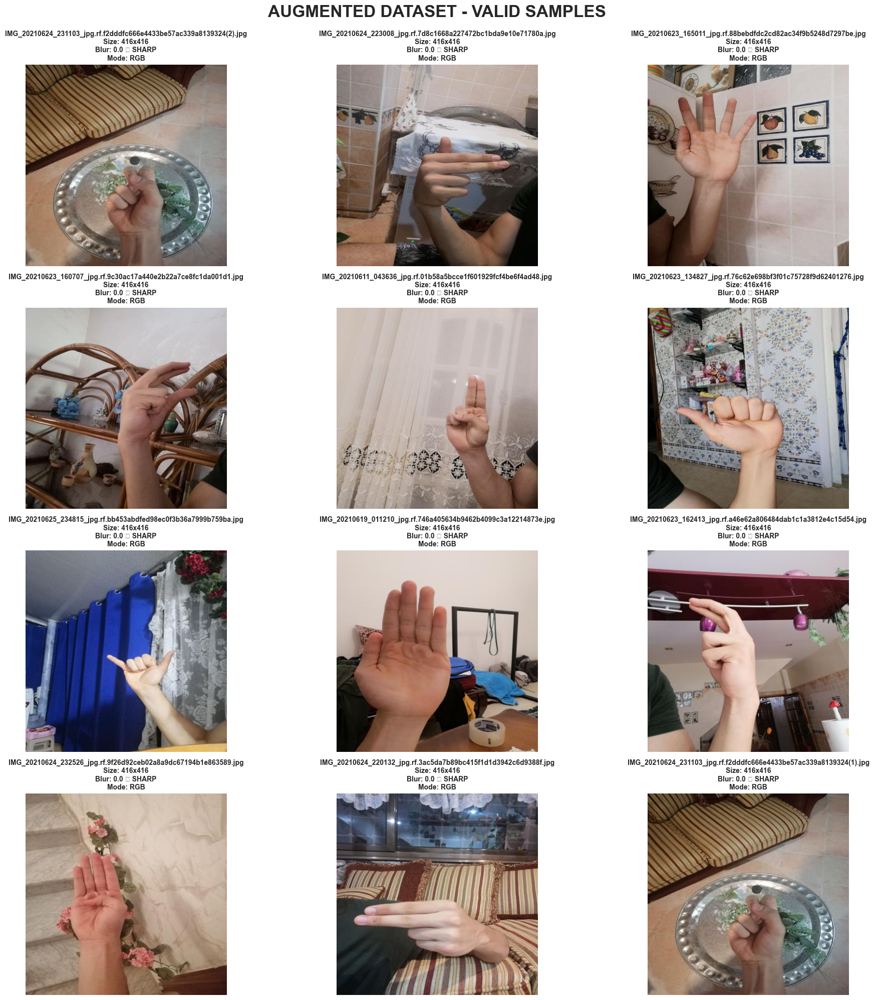

   ✅ Saved augmented_samples_valid.png

📸 Creating samples for TEST...


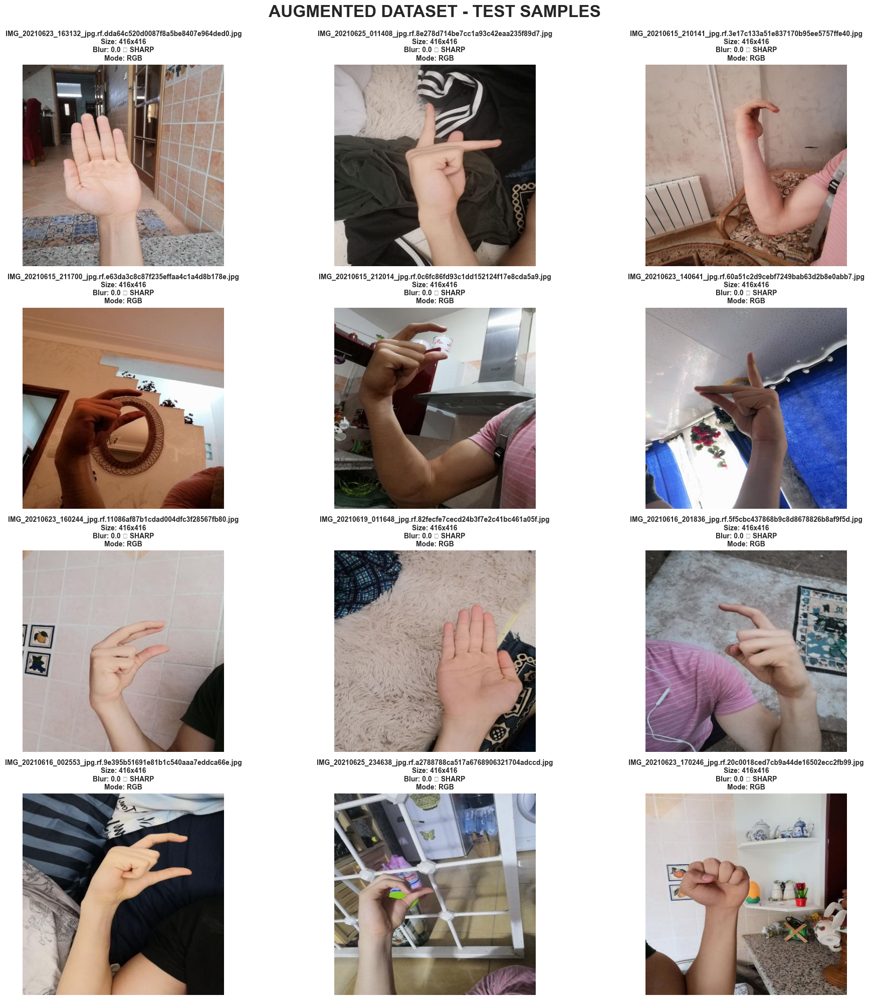

   ✅ Saved augmented_samples_test.png

🏷️  AUGMENTED LABEL VISUALIZATION


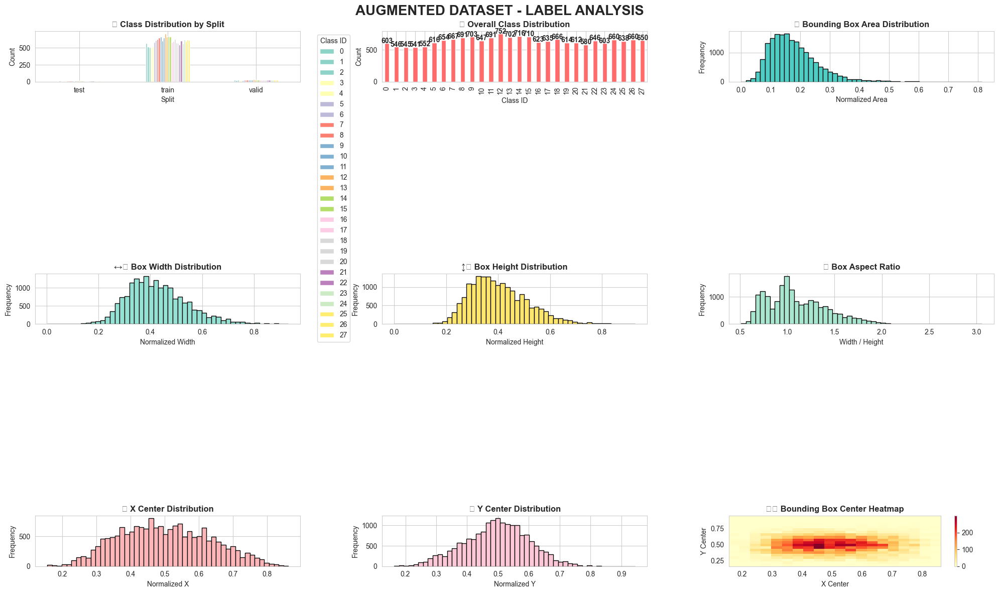


📊 AUGMENTED LABEL STATISTICS
Split  Total Labels  Unique Classes Avg Boxes/Image Avg Box Area Avg Width Avg Height
TRAIN         16872              28            1.00       0.1777    0.4271     0.4032
VALID           780              28            0.97       0.1737    0.4221     0.4006
 TEST           271              28            1.00       0.1822    0.4318     0.4055

📊 CLASS DISTRIBUTION
class_id   0    1    2    3    4    5    6    7    8    9   ...   18   19  \
split                                                       ...             
test        8   10    8    8   10    8   10   10   11   11  ...    9    8   
train     568  516  512  512  520  584  616  628  648  664  ...  628  580   
valid      27   20   25   21   22   24   28   29   32   28  ...   29   26   

class_id   20   21   22   23   24   25   26   27  
split                                             
test       10   10   10   10    9    9   10    9  
train     572  544  608  564  624  600  620  612  
valid      30 

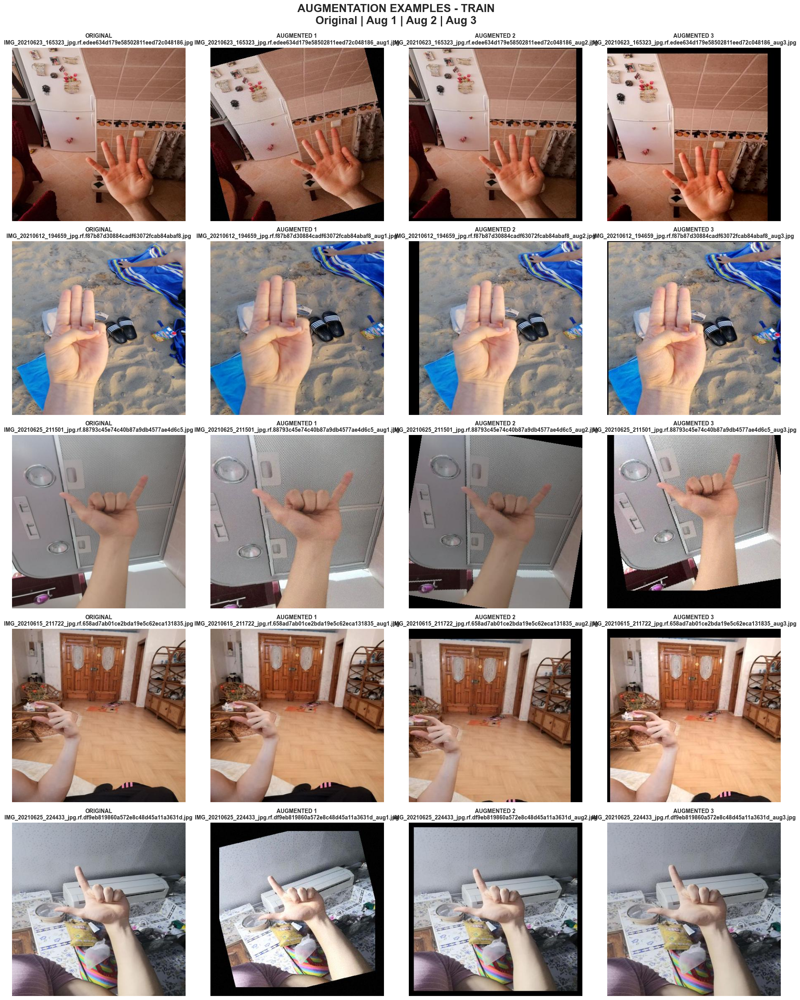

   ✅ Saved augmentation_examples_train.png

🔍 BEFORE vs AFTER COMPARISON


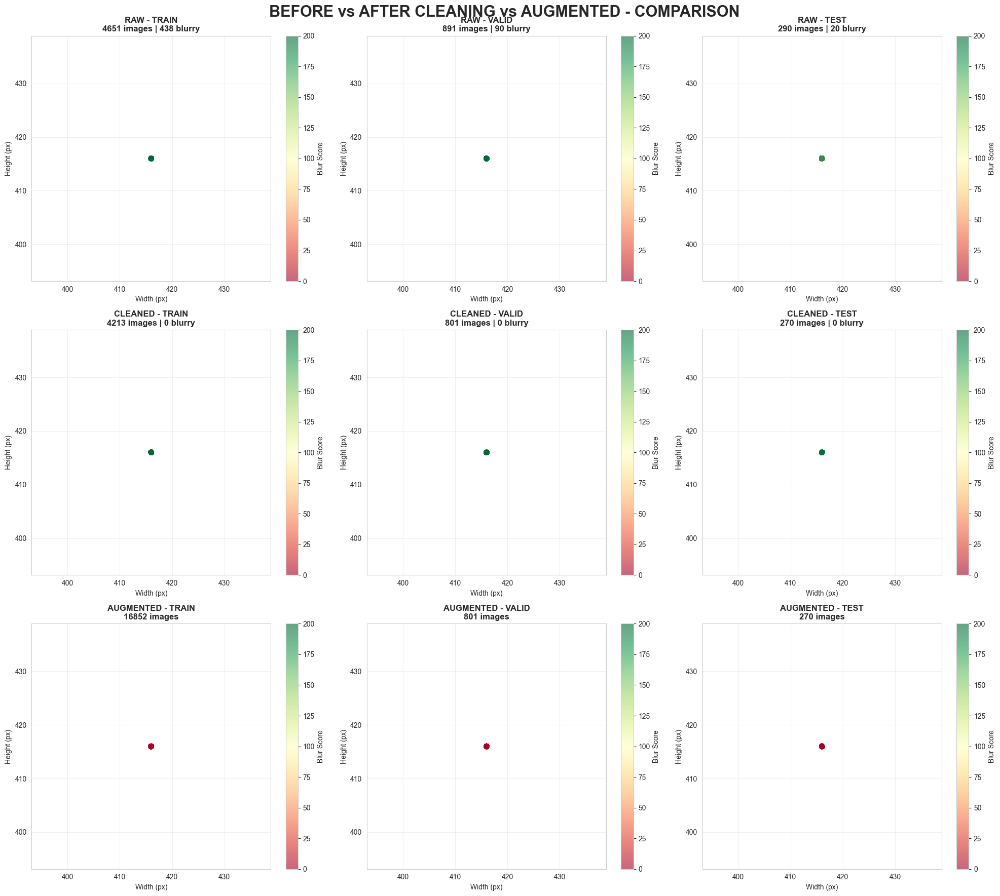


Split  Raw  Blurry Raw  Cleaned  Blurry Cleaned  Removed Kept %  Augmented Aug Increase
TRAIN 4651         438     4213               0      438  90.6%      16852       +12639
VALID  891          90      801               0       90  89.9%        801           +0
 TEST  290          20      270               0       20  93.1%        270           +0

✅ PIPELINE COMPLETE!

📊 Generated Visualizations:
   📈 Overview:
      - raw_dataset_overview.png
      - cleaned_dataset_overview.png
      - augmented_dataset_overview.png
      - augmentation_examples_train.png
      - before_after_augmented_comparison.png

   🖼️  Sample Images:
      - raw_samples_train/valid/test.png
      - cleaned_samples_train/valid/test.png
      - augmented_samples_train/valid/test.png

   🏷️  Label Analysis:
      - raw_label_analysis.png
      - cleaned_label_analysis.png
      - augmented_label_analysis.png

📂 Cleaned data saved to: dataset_cleaned
📂 Augmented data saved to: dataset_augmented


In [10]:
# ============================================================================
# MAIN EXECUTION
# ============================================================================

if __name__ == "__main__":
    
    # ========== STEP 1: LOAD RAW DATA ==========
    print("\n" + "="*80)
    print("STEP 1: LOADING RAW DATA (NO MODIFICATIONS!)")
    print("="*80)
    
    raw_stats = get_dataset_statistics(BASE_DIR, check_blur=True)
    
    # ========== STEP 2: VISUALIZE RAW DATA ==========
    print("\n" + "="*80)
    print("STEP 2: VISUALIZING RAW DATA")
    print("="*80)
    
    raw_combined_df = visualize_raw_dataset(raw_stats, title_prefix="RAW")
    visualize_samples_large(raw_stats, title_prefix="RAW", samples_per_split=12)
    visualize_labels(raw_stats, title_prefix="RAW")
    
    # ========== STEP 3: CLEAN THE DATA ==========
    print("\n" + "="*80)
    print("STEP 3: CLEANING THE DATA")
    print("="*80)
    
    import copy
    cleaned_stats = clean_dataset(
        copy.deepcopy(raw_stats), 
        min_size=32, 
        max_size=4096, 
        target_mode='RGB',
        blur_threshold=100,
        remove_blurry=True
    )
    
    # ========== STEP 4: COPY CLEANED DATA ==========
    copy_cleaned_data(cleaned_stats)
    
    # Reload cleaned stats
    cleaned_stats = get_dataset_statistics(CLEANED_BASE, check_blur=True)
    
    # ========== STEP 5: VISUALIZE CLEANED DATA ==========
    print("\n" + "="*80)
    print("STEP 5: VISUALIZING CLEANED DATA")
    print("="*80)
    
    cleaned_combined_df = visualize_raw_dataset(cleaned_stats, title_prefix="CLEANED")
    visualize_samples_large(cleaned_stats, title_prefix="CLEANED", samples_per_split=12)
    visualize_labels(cleaned_stats, title_prefix="CLEANED")
    
    # ========== STEP 6: AUGMENT THE DATA ==========
    print("\n" + "="*80)
    print("STEP 6: DATA AUGMENTATION")
    print("="*80)
    
    augment = input("Do you want to augment the dataset? (y/n): ").lower()
    if augment == 'y':
        aug_per_image = input("How many augmentations per image? (default: 3): ")
        aug_per_image = int(aug_per_image) if aug_per_image.strip() else 3
        
        augment_splits = input("Which splits to augment? (train/valid/test, comma-separated, default: train): ")
        augment_splits = [s.strip() for s in augment_splits.split(',')] if augment_splits.strip() else ['train']
        
        augmented_stats = augment_dataset(cleaned_stats, augmentations_per_image=aug_per_image, 
                                         splits_to_augment=augment_splits)
        
        # Reload augmented stats
        augmented_stats = get_dataset_statistics(AUGMENTED_BASE, check_blur=False)
        
        # ========== STEP 7: VISUALIZE AUGMENTED DATA ==========
        print("\n" + "="*80)
        print("STEP 7: VISUALIZING AUGMENTED DATA")
        print("="*80)
        
        augmented_combined_df = visualize_raw_dataset(augmented_stats, title_prefix="AUGMENTED")
        visualize_samples_large(augmented_stats, title_prefix="AUGMENTED", samples_per_split=12)
        visualize_labels(augmented_stats, title_prefix="AUGMENTED")
        visualize_augmentations(cleaned_stats, augmented_stats, samples=5)
        
        # ========== STEP 8: COMPARE ALL ==========
        compare_before_after(raw_stats, cleaned_stats, augmented_stats)
    else:
        augmented_stats = None
        # ========== STEP 8: COMPARE BEFORE vs AFTER ==========
        compare_before_after(raw_stats, cleaned_stats)
    
    # ========== FINAL REPORT ==========
    print("\n" + "="*80)
    print("✅ PIPELINE COMPLETE!")
    print("="*80)
    print(f"\n📊 Generated Visualizations:")
    print(f"   📈 Overview:")
    print(f"      - raw_dataset_overview.png")
    print(f"      - cleaned_dataset_overview.png")
    if augmented_stats:
        print(f"      - augmented_dataset_overview.png")
        print(f"      - augmentation_examples_train.png")
        print(f"      - before_after_augmented_comparison.png")
    else:
        print(f"      - before_after_comparison.png")
    print(f"\n   🖼️  Sample Images:")
    print(f"      - raw_samples_train/valid/test.png")
    print(f"      - cleaned_samples_train/valid/test.png")
    if augmented_stats:
        print(f"      - augmented_samples_train/valid/test.png")
    print(f"\n   🏷️  Label Analysis:")
    print(f"      - raw_label_analysis.png")
    print(f"      - cleaned_label_analysis.png")
    if augmented_stats:
        print(f"      - augmented_label_analysis.png")
    print(f"\n📂 Cleaned data saved to: {CLEANED_BASE}")
    if augmented_stats:
        print(f"📂 Augmented data saved to: {AUGMENTED_BASE}")
    print("="*80)